In [1]:
import scanpy as sc
import scvi
import mplscience

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
scvi.__version__
scvi.settings.seed = 0

Global seed set to 0


In [3]:
!curl -o ../prostate_visium.h5 https://cf.10xgenomics.com/samples/spatial-exp/2.0.0/Visium_FFPE_Human_Prostate_IF/Visium_FFPE_Human_Prostate_IF_filtered_feature_bc_matrix.h5
!curl -o ../spatial.tar.gz https://cf.10xgenomics.com/samples/spatial-exp/2.0.0/Visium_FFPE_Human_Prostate_IF/Visium_FFPE_Human_Prostate_IF_spatial.tar.gz
!tar -xf ../spatial.tar.gz 

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 18.1M  100 18.1M    0     0  37.9M      0 --:--:-- --:--:-- --:--:-- 37.8M
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 7613k  100 7613k    0     0  27.7M      0 --:--:-- --:--:-- --:--:-- 27.7M


In [4]:
!tar -xf ../spatial.tar.gz 

In [5]:
st_adata = sc.read_visium('..', genome=None, count_file='prostate_visium.h5', library_id='spatial/tissue_hires_image.png', load_images=True, source_image_path=None)

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/anndata/_core/anndata.py:1899: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/anndata/_core/anndata.py:1899: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [6]:
st_adata

AnnData object with n_obs × n_vars = 3460 × 17943
    obs: 'in_tissue', 'array_row', 'array_col'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [8]:
from scvi.hub import HubModel

hmo = HubModel.pull_from_huggingface_hub(
    repo_name="scvi-tools/tabula-sapiens-prostate-condscvi",
    cache_dir="../prostate",
    revision="main",
)

Fetching 3 files:  33%|███▎      | 1/3 [00:00<00:00,  5.14it/s]
model.pt: 100%|██████████| 4.57M/4.57M [00:00<00:00, 9.13MB/s]



































adata.h5ad: 100%|██████████| 369M/369M [00:10<00:00, 36.3MB/s]
Fetching 3 files: 100%|██████████| 3/3 [00:10<00:00,  3.64s/it]
README.md: 100%|██████████| 1.89k/1.89k [00:00<00:00, 20.8MB/s]


In [11]:
sc_adata = hmo.adata

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


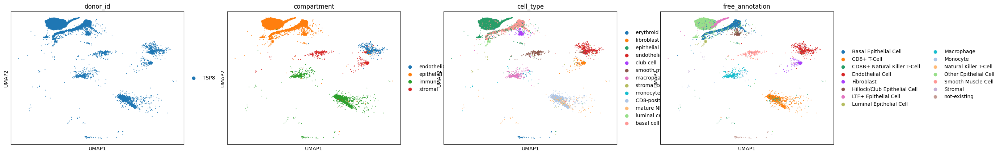

In [12]:
sc.pl.umap(sc_adata, color=['donor_id', 'compartment', 'cell_type', 'free_annotation'])

In [13]:
sc.pp.normalize_total(sc_adata)
sc.pp.log1p(sc_adata)

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


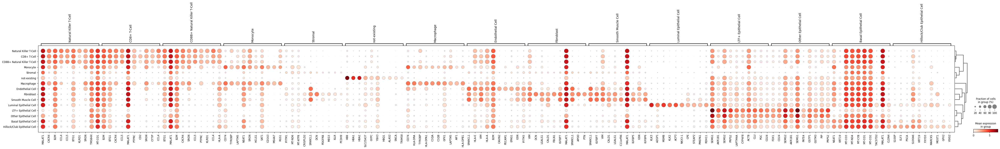

In [14]:
sc.tl.rank_genes_groups(sc_adata, groupby='free_annotation', use_raw=False)
sc.pl.rank_genes_groups_dotplot(sc_adata, use_raw=False)

In [15]:
sc_model = hmo.model

In [16]:
sc_adata.obs['cell_type'].value_counts()

epithelial cell                        6637
basal cell of prostate epithelium      3198
CD8-positive, alpha-beta T cell        1081
endothelial cell                        471
mature NK T cell                        430
macrophage                              317
club cell                               290
smooth muscle cell                      285
fibroblast                              207
luminal cell of prostate epithelium      60
erythroid progenitor cell                52
monocyte                                 33
stromal cell                             32
Name: cell_type, dtype: int64

In [17]:
import numpy as np

intersect = np.intersect1d(st_adata.var_names, sc_adata.var_names)
len(intersect), len(sc_adata.var_names), len(st_adata.var_names)

(3384, 4000, 17943)

Add missing genes in reference model here. DestVI will ignore those genes. It's important that no marker genes are missing. Here those are non-coding genes.

In [18]:
import anndata as ad

extra_genes = ad.AnnData(np.zeros([st_adata.shape[0], len(set(sc_adata.var_names) - set(intersect))]))
extra_genes.var_names = set(sc_adata.var_names) - set(intersect)
extra_genes.obs_names = st_adata.obs_names

In [21]:
st_adata.var_names_make_unique()

The history saving thread hit an unexpected error (OperationalError('database or disk is full')).History will not be written to the database.


In [22]:
st_adata_pre = ad.concat([st_adata, extra_genes], label='source', keys=['original', 'extra'], axis=1, merge='unique', uns_merge='unique')[:, sc_adata.var_names]

In [23]:
st_adata_pre.layers["counts"] = st_adata_pre.X.copy()

sc.pp.filter_cells(st_adata_pre, min_counts=100)
sc.pp.normalize_total(st_adata_pre, target_sum=10e4)
sc.pp.log1p(st_adata_pre)
st_adata_pre.raw = st_adata_pre

/tmp/ipykernel_1426573/3234410388.py:1: ImplicitModificationWarning: Setting element `.layers['counts']` of view, initializing view as actual.
  st_adata_pre.layers["counts"] = st_adata_pre.X.copy()


In [24]:
mplscience.set_style(reset_current=True, name="default")

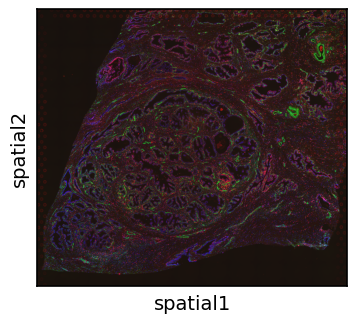

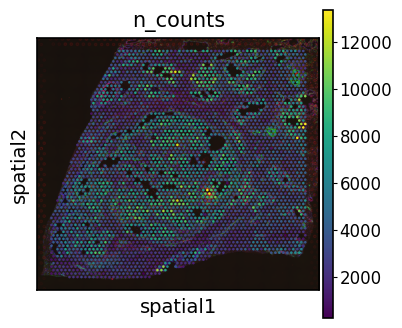

In [25]:
st_adata_pre.obsm['spatial'] = st_adata_pre.obsm['spatial'].astype(float)
sc.pl.spatial(st_adata_pre)
sc.pl.spatial(st_adata_pre, color=['n_counts'])

In [26]:
scvi.model.DestVI.setup_anndata(st_adata_pre, layer="counts")

In [27]:
st_model = scvi.model.DestVI.from_rna_model(st_adata_pre, sc_model, vamp_prior_p=5)
st_model.view_anndata_setup()

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/abc.py:119: FutureWarning: SparseDataset is deprecated and will be removed in late 2024. It has been replaced by the public classes CSRDataset and CSCDataset.

For instance checks, use `isinstance(X, (anndata.experimental.CSRDataset, anndata.experimental.CSCDataset))` instead.

For creation, use `anndata.experimental.sparse_dataset(X)` instead.

  return _abc_instancecheck(cls, instance)


Anndata setup with scvi-tools version 1.0.3.

Setup via `DestVI.setup_anndata` with arguments:

{'layer': 'counts'}

     Summary Statistics     
┏━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃ Summary Stat Key ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│     n_cells      │ 3460  │
│      n_vars      │ 4000  │
└──────────────────┴───────┘

              Data Registry              
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃  scvi-tools Location   ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │ adata.layers['counts'] │
│    ind_x     │ adata.obs['_indices']  │
└──────────────┴────────────────────────┘

In [28]:
st_model.train(max_epochs=2000, plan_kwargs={'min_kl_weight': 0.01, 'max_kl_weight': 1.})

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA GeForce RTX 3090') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 2000/2000: 100%|██████████| 2000/2000 [06:38<00:00,  4.90it/s, v_num=1, train_loss_step=1.46e+7, train_loss_epoch=1.51e+7]

`Trainer.fit` stopped: `max_epochs=2000` reached.


Epoch 2000/2000: 100%|██████████| 2000/2000 [06:38<00:00,  5.02it/s, v_num=1, train_loss_step=1.46e+7, train_loss_epoch=1.51e+7]


In [29]:
st_model.history["elbo_train"].iloc[30:].plot()

<Axes: xlabel='epoch'>

In [30]:
st_adata_pre.obsm["proportions"] = st_model.get_proportions()
st_adata_pre.obsm["proportions"].head(5)

,"CD8-positive, alpha-beta T cell",basal cell of prostate epithelium,club cell,endothelial cell,epithelial cell,erythroid progenitor cell,fibroblast,luminal cell of prostate epithelium,macrophage,mature NK T cell,monocyte,smooth muscle cell,stromal cell
AAACAAGTATCTCCCA-1,0.024524,0.011911,0.005944,0.018846,0.039645,0.170641,0.028810,0.025818,0.032590,0.016412,0.109285,0.014493,0.501083
AAACAATCTACTAGCA-1,0.031607,0.065121,0.069957,0.013373,0.050227,0.209906,0.014242,0.073234,0.022682,0.027395,0.101110,0.013466,0.307680
AAACACCAATAACTGC-1,0.024151,0.011517,0.015690,0.013305,0.013405,0.193111,0.023981,0.038649,0.012792,0.026271,0.054774,0.011887,0.560466
AAACAGAGCGACTCCT-1,0.034357,0.028779,0.019828,0.014689,0.038703,0.175891,0.018619,0.035271,0.010978,0.040271,0.058595,0.016660,0.507359
AAACAGCTTTCAGAAG-1,0.056902,0.054460,0.032139,0.030914,0.029575,0.154327,0.015583,0.035381,0.023592,0.047837,0.110792,0.009358,0.399139


In [31]:
st_adata_pre.obs['sample'] = 'Visium_FFPE_Human_Prostate_IF'

In [32]:
ct_list = st_adata_pre.obsm["proportions"].columns
for ct in ct_list:
    data = st_adata_pre.obsm["proportions"][ct].values
    st_adata_pre.obs[ct] = np.clip(data, 0, np.quantile(data, 0.99))

In [33]:
ct_main = [None, 'smooth muscle cell', 'fibroblast', 'luminal cell of prostate epithelium']

In [63]:
ct_supplement = [
    'CD8-positive, alpha-beta T cell', 'basal cell of prostate epithelium',
    'club cell', 'endothelial cell', 'epithelial cell',
    'erythroid progenitor cell', 'macrophage',
    'mature NK T cell', 'monocyte', 'stromal cell']

In [64]:
st_adata_pre

AnnData object with n_obs × n_vars = 3460 × 4000
    obs: 'in_tissue', 'array_row', 'array_col', 'n_counts', '_indices', 'sample', 'CD8-positive, alpha-beta T cell', 'basal cell of prostate epithelium', 'club cell', 'endothelial cell', 'epithelial cell', 'erythroid progenitor cell', 'fibroblast', 'luminal cell of prostate epithelium', 'macrophage', 'mature NK T cell', 'monocyte', 'smooth muscle cell', 'stromal cell'
    var: 'source'
    uns: 'spatial', 'log1p', '_scvi_uuid', '_scvi_manager_uuid'
    obsm: 'spatial', 'proportions', 'CD8-positive, alpha-beta T cell_gamma', 'basal cell of prostate epithelium_gamma', 'club cell_gamma', 'endothelial cell_gamma', 'epithelial cell_gamma', 'erythroid progenitor cell_gamma', 'fibroblast_gamma', 'luminal cell of prostate epithelium_gamma', 'macrophage_gamma', 'mature NK T cell_gamma', 'monocyte_gamma', 'smooth muscle cell_gamma', 'stromal cell_gamma'
    layers: 'counts'

In [69]:
sc.settings.figdir = '/home/cane/Documents/yoseflab/can/scvi-hub/scvi-hub-reproducibility/figures/figures_spatial/'

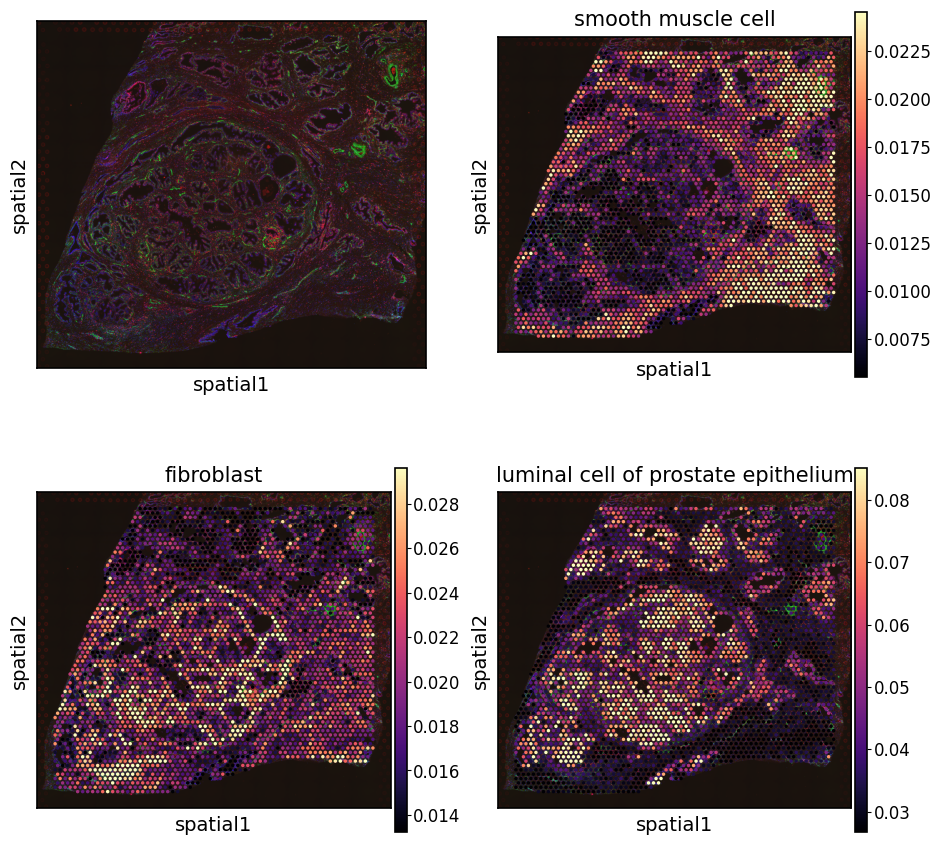

In [70]:
# plot in spatial coordinates
with plt.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(st_adata_pre, cmap='magma',
                  # show first 8 cell types
                  color=ct_main,
                  ncols=2,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  spot_size=200, vmin=[None, 'p10', 'p10', 'p10'], vmax=[None, 'p95', 'p95', 'p95'],
                  save='main_fig_deconvolution.svg'
                 )

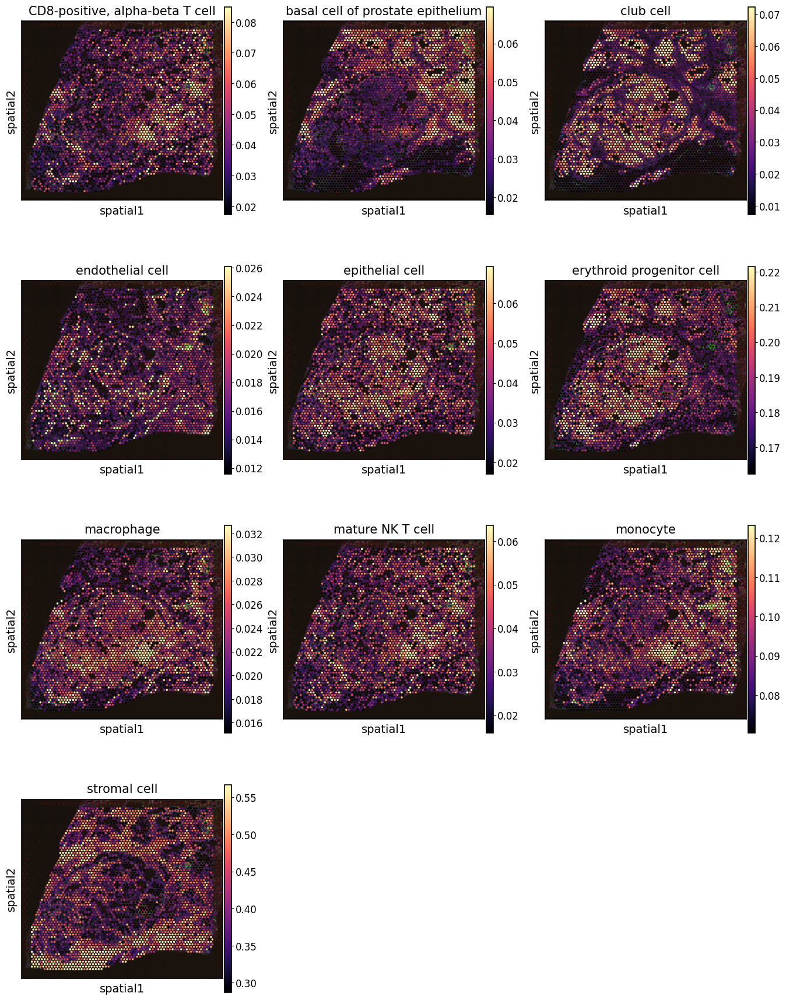

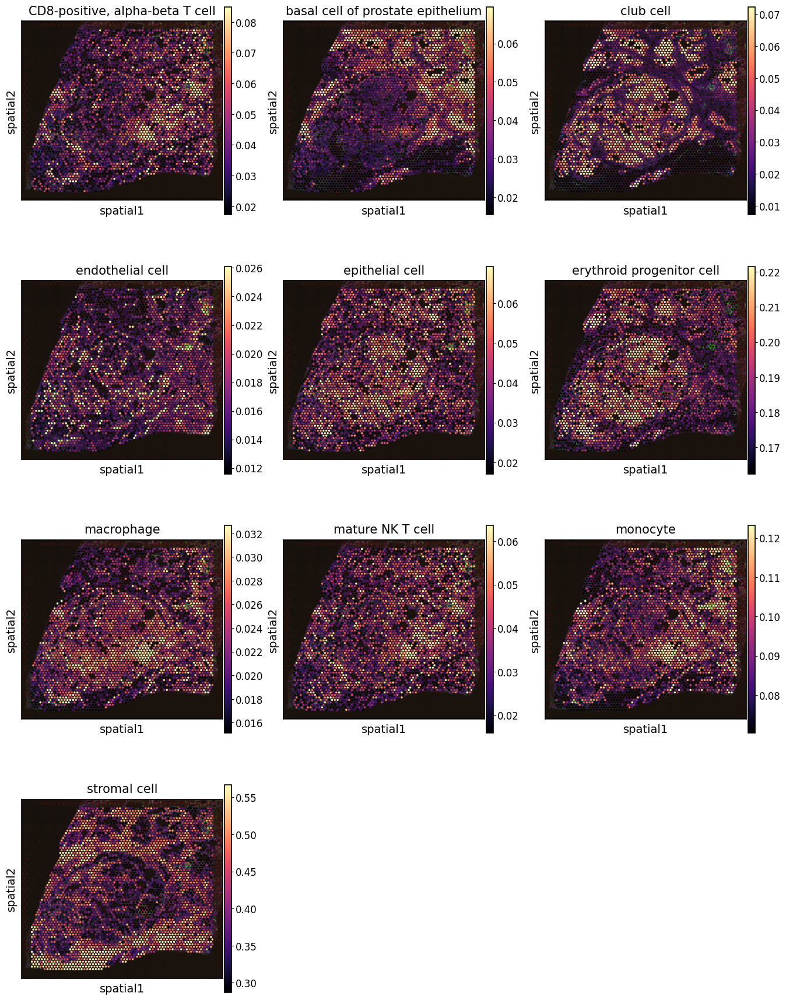

In [72]:
# plot in spatial coordinates
with plt.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(st_adata_pre, cmap='magma',
                  # show first 8 cell types
                  color=ct_supplement,
                  ncols=3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  spot_size=200, vmin='p10', vmax='p95',
                  save='other_fig_deconvolution.svg'
    )

## For completeness other part of destVI evaluation.
We haven't used it here.

In [41]:
import destvi_utils

In [42]:
# more globally, the values of the gamma are all summarized in this dictionary of data frames
for ct, g in st_model.get_gamma().items():
  st_adata_pre.obsm["{}_gamma".format(ct)] = g

In [46]:
destvi_utils.automatic_proportion_threshold?

Signature:
destvi_utils.automatic_proportion_threshold(
    st_adata,
    kind_threshold='primary',
    output_file=None,
    ct_list=None,
    key_proportions='proportions',
    key_spatial='spatial',
)
Docstring:
Function to compute automatic threshold on cell type proportion values.
For further reference check [Lopez22]_.

Parameters
----------
st_adata
    Spatial sequencing dataset with proportions in obsm['proportions'] and spatial location in
    obsm['spatial']
kind_threshold
    Which threshold value to use. Supported are 'primary', 'secondary'.
    'min_value' uses the minimum of primary and secondary threshold for each cell type.
output_file
    File where html output is stored. None means displaying the results and not storing them.
    Defaults to None.
ct_list
    Celltypes to use. Defaults to all celltypes.
key_proportions
    Obsm key pointing to cell-type proportions.
key_spatial
    Obsm key pointing to location of cells.

Returns
-------
ct_thresholds
    Dictionary 

100%|██████████| 100/100 [00:00<00:00, 430.89it/s]


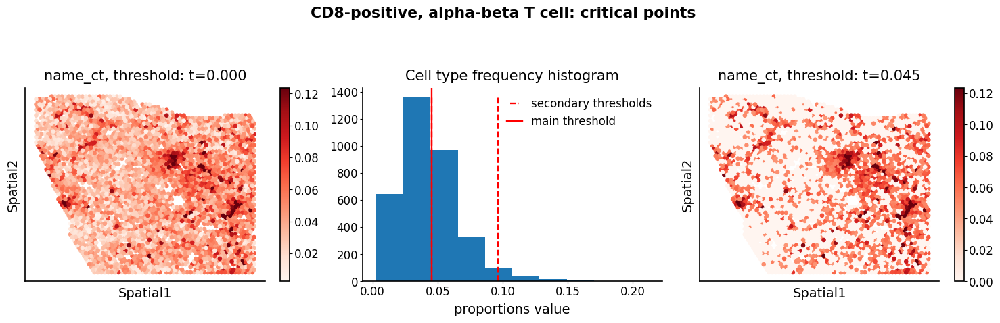

100%|██████████| 100/100 [00:00<00:00, 10271.85it/s]


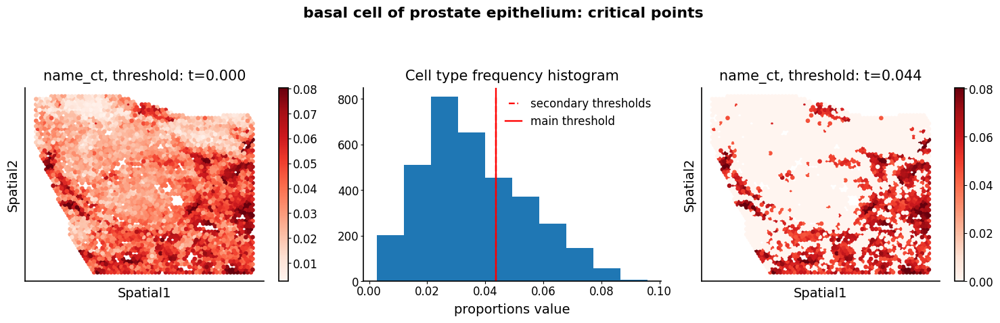

100%|██████████| 100/100 [00:00<00:00, 10873.96it/s]


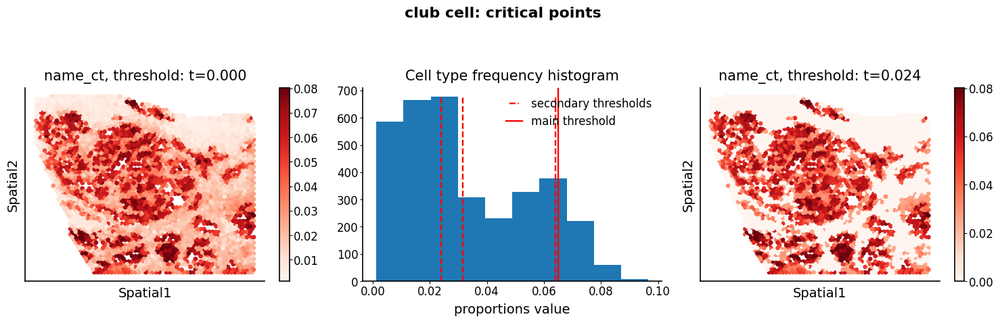

100%|██████████| 100/100 [00:00<00:00, 8573.10it/s]


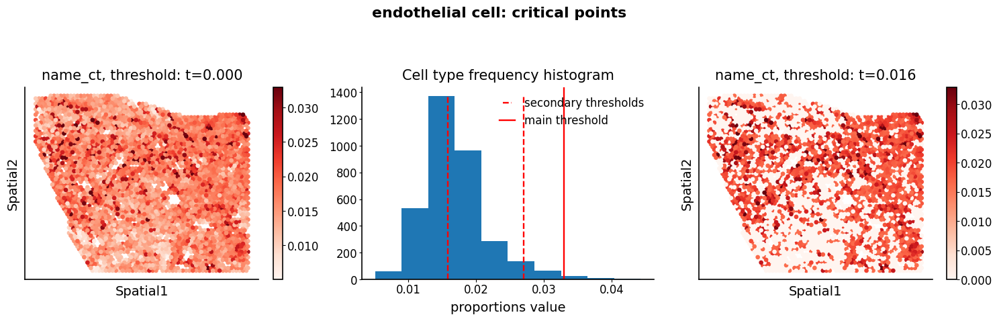

100%|██████████| 100/100 [00:00<00:00, 9995.24it/s]


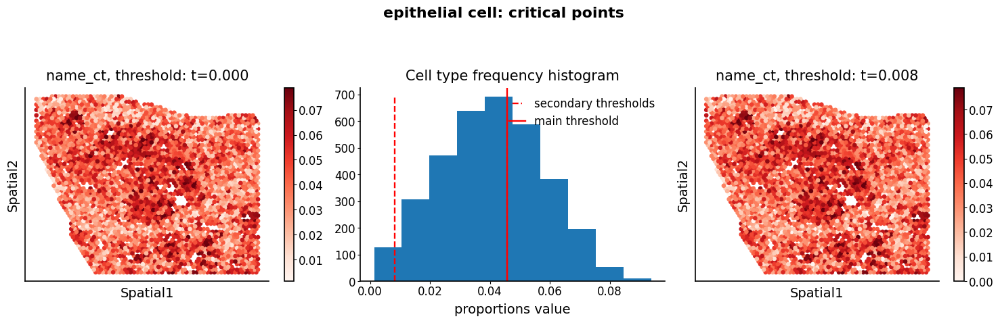

100%|██████████| 100/100 [00:00<00:00, 5857.48it/s]


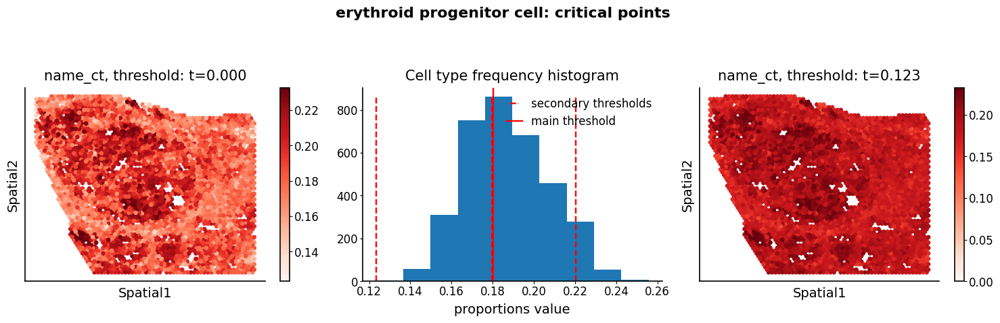

100%|██████████| 100/100 [00:00<00:00, 9151.08it/s]


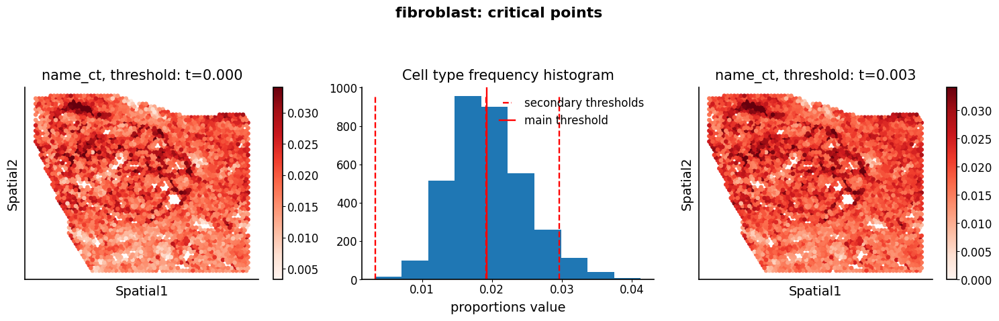

100%|██████████| 100/100 [00:00<00:00, 10773.41it/s]


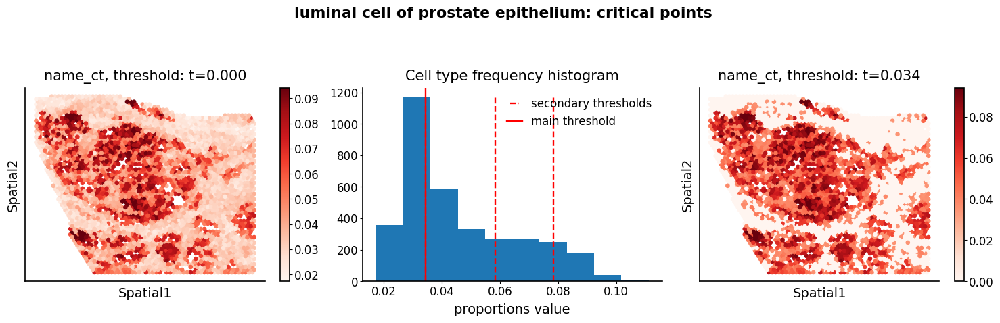

100%|██████████| 100/100 [00:00<00:00, 10533.95it/s]


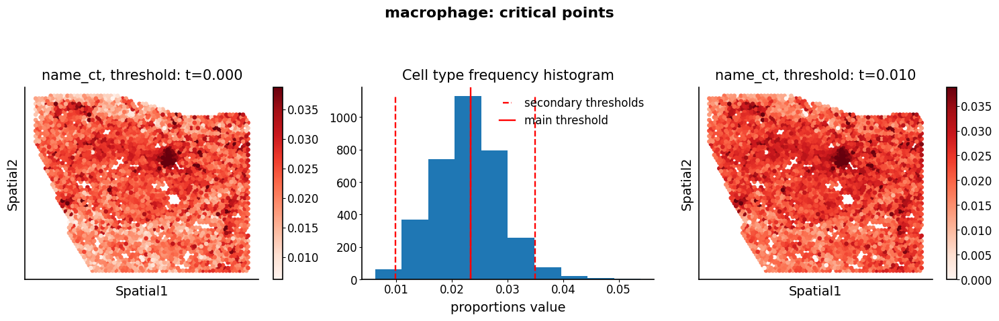

100%|██████████| 100/100 [00:00<00:00, 10012.18it/s]


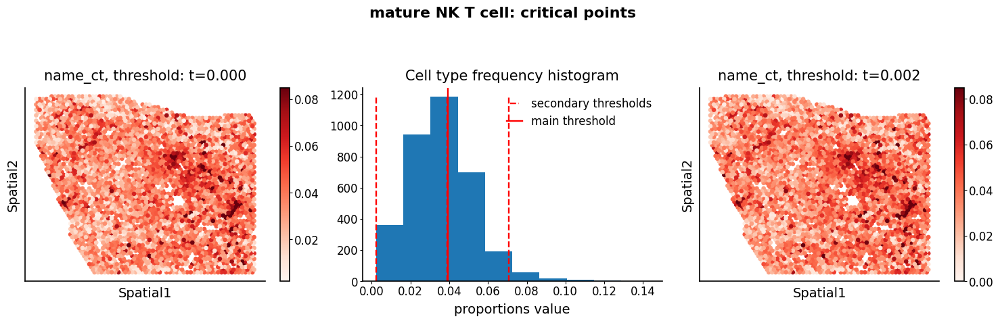

100%|██████████| 100/100 [00:00<00:00, 9653.84it/s]


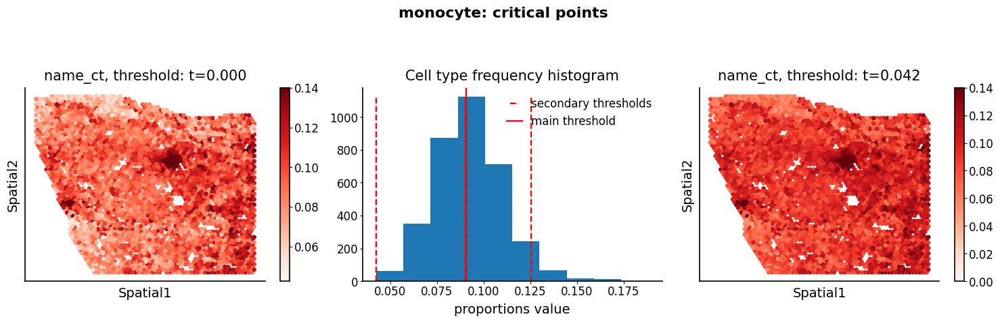

100%|██████████| 100/100 [00:00<00:00, 10836.87it/s]


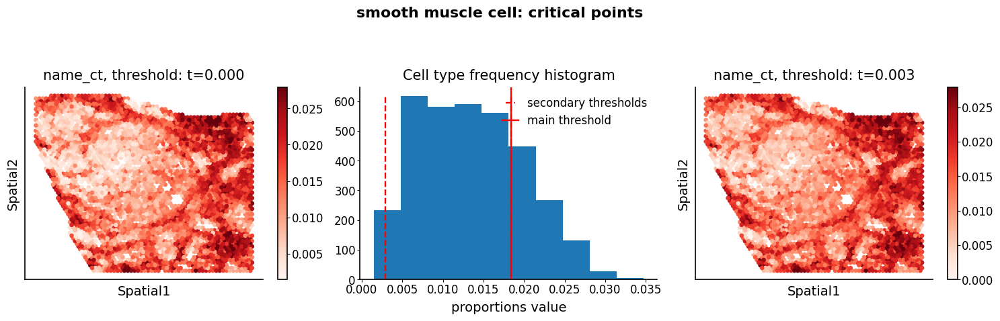

100%|██████████| 100/100 [00:00<00:00, 10446.85it/s]


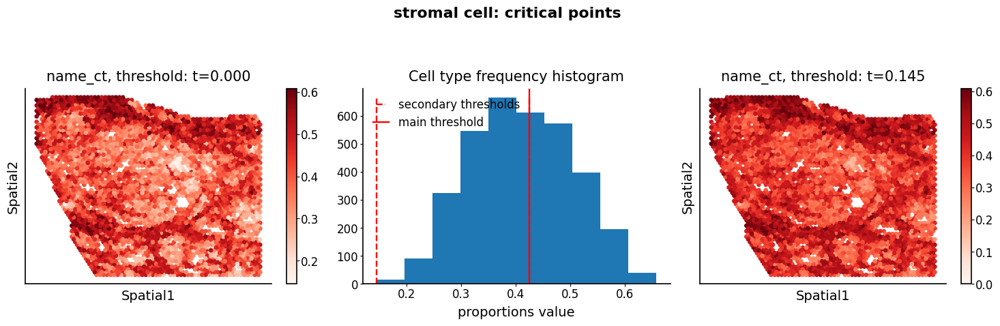

In [50]:
ct_thresholds = destvi_utils.automatic_proportion_threshold(st_adata_pre, ct_list=ct_list, kind_threshold='secondary', key_proportions='proportions')

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/cmap2d/util.py:32: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  bary_coords = la.lstsq(self._a,b)[0]


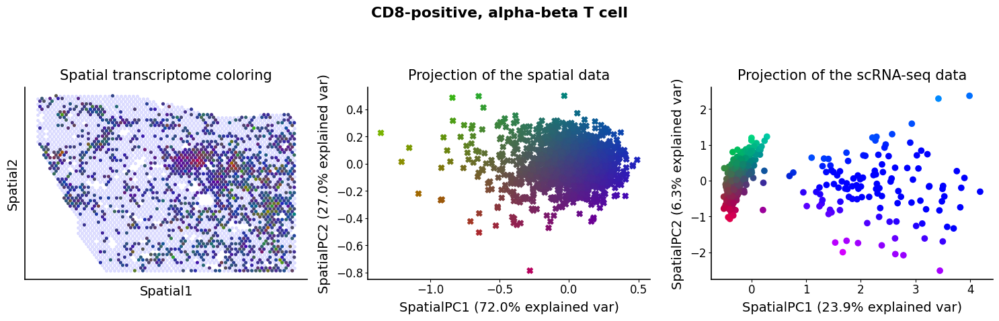

Genes associated with SpatialPC1

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

RPS3, MT-CYB, ACTB, HLA-E, RPL23A, DDX5, MT-RNR2, RPS16, MT-ATP8, RPL32, RPL18A, RPLP2, HLA-B, UBC, JUNB, HLA-A, 
MT-ND6, ACTG1, MT-ND2, RPS21, HSPE1, MT-CO1, MT-CO3, JUN, DUSP1, RPS15, MT-ATP6, RPL13A, MYL12A, H3-3B, RPL38, 
RPL21, RPS12, RPS13, RPL3, BTG1, RPS23, RPL23, RPS27, MYL6, IL2RG, RPL30, MT-CO2, DNAJB1, RPL14, MT-ND5, POTEI, 
CD3E, HSPA8, RPL18

---------------------------------------------------------------------------------------

Cytoplasmic ribosomal proteins*, Influenza viral RNA transcription and replication*, Influenza infection*, 
Translation*, Protein metabolism*, Disease*, Cap-dependent translation initiation*, Gene expression*, Activation of
mRNA upon binding of the cap-binding complex and eIFs, and subsequent binding to 43S*, T cell receptor regulation 
of apoptosis*

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

HSPA1B, PIP, HSPA1A, WFDC2, CYP4F8, PDK4, ADIRF, NUPR1, CRYAB, SLPI, CST3, PEBP1P3, PTGS2, CLDN4, KRT7, SELENOP, 
PATE4, FAM3D, RNASE1, PIGC, KRT19, BEX3, PNMT, TACSTD2, LCN2, Metazoa_SRP_ENSG00000274008, KLK3, MUC6, MSMB, 
PPP1R1B, ODR4, MFSD2A, ID4, TBX3, AQP2, CDO1, GATA2, RP3-395M20.12, SCGB3A1, AZGP1, CLDN3, PMEPA1, ZDHHC20P1, 
KRT17, TCEAL9, SNCG, ABCG2, GNG11, TESC, HBA1

---------------------------------------------------------------------------------------

Oncostatin M*, Mitochondrial pathway of apoptosis: multidomain Bcl-2 family*, BDNF signaling pathway*, TGF-beta 
regulation of extracellular matrix*, EGFR1 pathway, Mitochondrial pathway of apoptosis: caspases, Apoptosis 
modulation by HSP70, Antigen processing and presentation, Tight junction interactions, p38 alpha/beta MAPK 
downstream pathway

Genes associated with SpatialPC2

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

HSPA1B, SLC7A2, JAKMIP1, KB-1980E6.3, GFM2, TMEM244, CTB-50L17.16, MAP3K2, CNOT6L, VEGFA, RP11-356K23.1, PIP, 
CYREN, PHAX, NUP153, DENND10, RP11-489E7.4, HSPA1A, CYFIP1, RBP7, OGT, NOSTRIN, IL1A, COX11, TMCO3, SFRP2, FGF7, 
SLC14A1, NCK1, SYNM, SDCCAG8, C21orf91, PIGO, FBN1, SENP6, SNRNP27, TMEM39A, COL6A3, ASB8, DGLUCY, CAND1, RALB, 
STAP1, LAT2, APOC2, CTD-2647E9.3, PCDH17, C5orf15, TMEM165, PDK4

---------------------------------------------------------------------------------------

MAPK signaling pathway, Beta-1 integrin cell surface interactions, Apoptosis modulation by HSP70, Hypertrophy 
pathway, T cell signal transduction, VEGFR1 pathway, TGF-beta regulation of extracellular matrix, Prion diseases, 
Spliceosome, BDNF signaling pathway

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

ACTG1, RPS28, RPL7A, RPLP2, RPL21, RPS3, RPL38, RPL13A, RPL34, RPS13, RPS12, RPL18, RPS15, RPL18A, ELP2, RPS3A, 
RPL9, RPS27, HINT1, RPLP1, RPL12, RPL13, RPL27, RPL36AL, RPL10A, HLA-B, CEBPG, DBI, PIK3IP1, ISG20, RPS21, RPS19, 
RPS18, TMSB10, NELFCD, CHCHD2, RPL30, RPL11, RPL23A, RPL10, RPL7, RPS29, RPL39, MCM3AP, POTEI, IL32, RPL15, CCL5, 
RPL31, NAMPT

---------------------------------------------------------------------------------------

Cytoplasmic ribosomal proteins*, Influenza viral RNA transcription and replication*, Translation*, Influenza 
infection*, Protein metabolism*, Cap-dependent translation initiation*, Disease*, Gene expression*, Activation of 
mRNA upon binding of the cap-binding complex and eIFs, and subsequent binding to 43S*, T cell receptor regulation 
of apoptosis*

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/cmap2d/util.py:32: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  bary_coords = la.lstsq(self._a,b)[0]


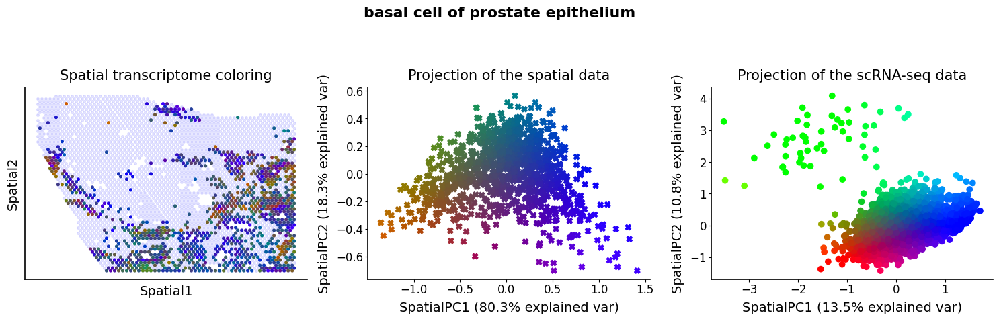

Genes associated with SpatialPC1

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

CYP4F8, FADS2, SEMG2, SERPINA5, PATE4, SEMG1, MUC6, ABCG2, FAM3D, SLC26A3, ACSL6, PIP, AQP2, LPL, PLCB1, PGC, CDO1,
MT-ND3, RNASE1, ZFHX4, CD84, IL1RL1, CD38, FDX1, ENPP3, ST3GAL1, HSD17B6, FADS1, RDH16, PON3, TUBA3D, ANXA13, 
PODXL, TMPRSS2, LTF, HECW1, NOSTRIN, MT1G, ANKS1A, SPINK13, CYP2E1, ADIRF, SH3BP5, TTC39A, CD36, CAPN5, APBB1IP, 
FERMT3, STAP1, COG3

---------------------------------------------------------------------------------------

Metabolism*, PPAR signaling pathway*, Linoleic acid metabolism*, Vitamin A and carotenoid metabolism*, 
Alpha-linolenic (omega3) and linoleic (omega6) acid metabolism, Biosynthesis of unsaturated fatty acids, Nicotinate
and nicotinamide metabolism, Termination of O-glycan biosynthesis, Pancreatic secretion, Fatty acid beta oxidation

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

ACTG1, ACTB, FOS, EGR1, EIF1, UBC, JUNB, ZFP36, RPL7, RPS3, POTEI, PPP1R15A, EEF1A1, BTG2, ATF3, H3-3B, FOSB, 
ZFP36L1, MYL12A, CCNL1, PTMA, TACSTD2, PERP, RPS6, NEAT1, KLF6, CDKN1A, CLDN4, ITM2B, RPL31, PDLIM1, MYADM, DDX5, 
KRT19, RPS3A, S100A6, FTH1, RPL13A, ZFAND5, TNFRSF12A, S100A10, MT-ATP8, MALAT1, RPL9, DST, HSP90AB1, RPL21, TGIF1,
RPL3, ANXA2

---------------------------------------------------------------------------------------

BDNF signaling pathway*, Translation*, Cytoplasmic ribosomal proteins*, Influenza viral RNA transcription and 
replication*, Influenza infection*, Disease*, T cell receptor regulation of apoptosis*, Gene expression*, Protein 
metabolism*, Cap-dependent translation initiation*

Genes associated with SpatialPC2

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

RPL28, RPL41, RPL12, RPS23, RPLP1, RPL36, RPS12, RPS14, RPL13, RPS28, RPL34, MT-ND4, MIF, RPL35A, RPL26, RPS16, 
RPS27, MT-CO2, FAU, MT-CO3, RPS24, RPS18, RPL11, RPS9, MT-ATP6, RPL39, RPL32, RPS10, RPL30, RPS15, RPS25, RPL19, 
MT-ND4L, RPL10, MT-CYB, RPS8, RPL29, RPS4X, RPL37, MT-CO1, MALAT1, RPS2, MT-RNR2, RPS19, EEF1A1, MTATP6P1, COX7C, 
RPS6, RPLP2, RPL18A

---------------------------------------------------------------------------------------

Cytoplasmic ribosomal proteins*, Influenza viral RNA transcription and replication*, Translation*, Influenza 
infection*, Protein metabolism*, Disease*, Gene expression*, Cap-dependent translation initiation*, Activation of 
mRNA upon binding of the cap-binding complex and eIFs, and subsequent binding to 43S*, T cell receptor regulation 
of apoptosis

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

PTPRC, STAT4, PTPN22, GALNT15, ABCB1, ROBO4, FLT1, TNFRSF1B, CD2, IL7R, CCL5, RUNX3, ENPP2, CLEC14A, KDR, SCML4, 
GPR65, PRF1, FMO2, C16orf54, EMB, SOX18, EMCN, PTPN7, RP11-284N8.3, INHBB, ERG, PECAM1, FYB1, CD93, SAMD3, TRDC, 
PTPRB, KLRC2, KLRC4, PDE2A, CD96, AC006129.2, DNAI3, PCAT19, THEMIS, TRGV10, ADGRF5, GPR171, IKZF1, TM4SF18, DLL4, 
LCP1, GBP5, CD3G

---------------------------------------------------------------------------------------

Interleukin-2 signaling pathway*, T cell receptor regulation of apoptosis*, T helper cell surface molecules*, Type 
I interferon (interferon-alpha/beta) pathway*, NO2-dependent IL-12 pathway in NK cells*, Jak-STAT signaling 
pathway*, CD8/T cell receptor downstream pathway*, Ras-independent pathway in NK cell-mediated cytotoxicity*, 
Cytokine-cytokine receptor interaction*, Neurophilin interactions with VEGF and VEGF receptor*

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/cmap2d/util.py:32: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  bary_coords = la.lstsq(self._a,b)[0]


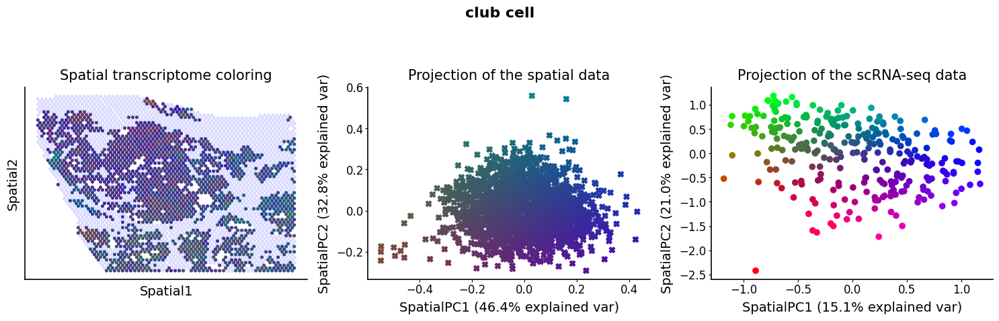

Genes associated with SpatialPC1

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

PATE4, SPINK13, PRPS2, RP11-1I2.1, NMUR1, AKR1B1, LINC00861, TRGV3, MMRN1, CA2, BFSP2-AS1, MLC1, ANXA13, LRRC63, 
GPR18, RP11-325F22.2, CXCL14, C1QTNF7, PURPL, CA1, CDO1, ABCG2, RP11-344P13.6, PEG10, ADAMTS6, CD38, AC006129.2, 
TRAV17, RP11-517H2.8, RP11-284N8.3, BTLA, RP11-95M15.2, JAKMIP1, CYP19A1, TRAT1, RPL7P16, SFRP4, PROK1, CHI3L1, 
CARMIL2, APBB1IP, MYOT, LINC02576, RP11-214O1.3, LINC00892, TBC1D10C, HSD17B6, TRDC, HEMGN, TESPA1

---------------------------------------------------------------------------------------

Oxygen/carbon dioxide exchange in erythrocytes, Reversible hydration of carbon dioxide, Nitrogen metabolism, 
Steroid hormone, vitamin A, and vitamin D metabolism, Steroid hormone biosynthesis, Abacavir transmembrane 
transport, TGF-beta regulation of extracellular matrix, Pregnenolone biosynthesis, Integrin alpha-2b beta-3 
signaling, Metabolism

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

CD63, MT-CO1, MT-ND5, MT-ATP6, TSPAN1, B2M, HLA-C, MT-ND4, MT-RNR1, MT-CYB, SLC44A4, PSAP, APLP2, SLC39A6, MT-ND1, 
MTATP6P1, HLA-A, SERF2, GALNT3, CMPK1, CTSH, HLA-B, SRP14, VAMP8, TMEM165, ELF3, DSTN, TCF25, MYL6, MT-CO3, RTN4, 
H2AJ, VSIG2, FXYD3, AGR2, MT-CO2, GNPTAB, LGALS3, FLNB, ADD3, TC2N, ARID1B, ACADVL, ZBTB38, MACROH2A1, MT-ND2, CD9,
ADIRF, S100P, LIMA1

---------------------------------------------------------------------------------------

Endosomal/vacuolar pathway*, Antigen processing: cross presentation*, Antigen processing and presentation*, 
Interferon signaling*, Interferon-gamma signaling pathway*, Allograft rejection*, Graft-versus-host disease*, Type 
1 diabetes mellitus*, Immunoregulatory interactions between a lymphoid and a non-lymphoid cell*, Lysosome*

Genes associated with SpatialPC2

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

MT-CO3, MT-CO1, MT-CYB, MT-ATP6, MT-CO2, RPL37, MTATP6P1, RPLP2, RPL38, MT-ND3, S100A6, RPL27A, RPL37A, S100A11, 
COX7C, UBC, ANXA2, ELF3, RPS29, RPS11, MPZL2, RPS18, RTN4, RPS21, RPL31, RPS14, CTSH, RPS24, DHRS3, RPL28, RPL39, 
MT-ND4, RPLP1, RPL29, ITM2B, RPL27, PERP, RPL13A, EMP2, RPS15A, RPS16, RPL34, MT-ND1, HINT1, RPS2, RPL35, TACSTD2, 
RPL32, RPL36, RPS28

---------------------------------------------------------------------------------------

Cytoplasmic ribosomal proteins*, Influenza viral RNA transcription and replication*, Influenza infection*, 
Translation*, Protein metabolism*, Disease*, Cap-dependent translation initiation*, Gene expression*, Activation of
mRNA upon binding of the cap-binding complex and eIFs, and subsequent binding to 43S*, T cell receptor regulation 
of apoptosis*

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

SEMG1, SEMG2, PIP, SLC26A3, FADS2, AQP2, MFSD2A, ENPP3, CYP4F8, PATE4, SERPINA5, AKR1B1, MUC6, GSTM3, PTGS2, ABCG2,
SLC26A2, CA2, PRPS2, PGC, CDO1, LPL, PDK4, FDX1, ACSL6, SERPINA1, SPINK13, HSD17B6, CD24, ANXA13, PATE1, RNASE1, 
CST4, SULT2A1, TUBA3D, RDH16, CYP2E1, ELOVL5, MT1F, IL1RL1, DNAJC15, PON3, SLFN11, PEG10, DPYSL2, HBB, KIAA1210, 
F2RL3, CD38, LINC00844

---------------------------------------------------------------------------------------

Metabolism*, Metapathway biotransformation*, Linoleic acid metabolism*, SLC26 family multifunctional anion 
exchangers*, Mechanism of acetaminophen activity and toxicity*, Oxygen/carbon dioxide exchange in erythrocytes*, 
Alpha-linolenic (omega3) and linoleic (omega6) acid metabolism*, Biological oxidations*, TGF-beta regulation of 
extracellular matrix*, Phase I of biological oxidations: functionalization of compounds

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/cmap2d/util.py:32: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  bary_coords = la.lstsq(self._a,b)[0]


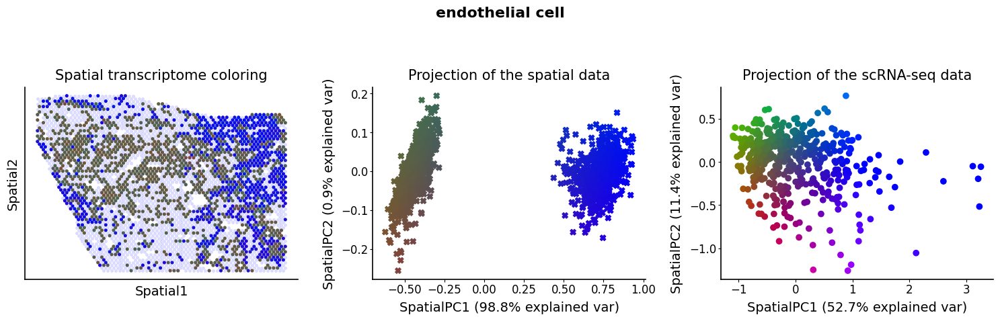

Genes associated with SpatialPC1

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

POLR2L, PATE4, PRPS2, GSTP1, CLU, SSR4, RPLP0, RPL41, GSTM3, SEMG1, PPP1R1B, CST3, SPINK13, AKR1B1, ATP5F1E, NNMT, 
PERP, RPS2, SEMG2, ELF5, RDH16, RPL12, RPS18, SERPINA1, RPL35, RPL10A, DBI, ANXA13, ACTN1, FAM107B, CDO1, RPL26, 
CD24, RPL7A, COX7C, GPM6A, NUPR1, RPL10, RPL13, RPS5, RPL39, RPS12, EEF1B2, PGC, RPS4X, PIP, UQCRH, RPLP1, RPS14, 
FADS2

---------------------------------------------------------------------------------------

Translation*, Influenza viral RNA transcription and replication*, Cytoplasmic ribosomal proteins*, Influenza 
infection*, Protein metabolism*, Cap-dependent translation initiation*, Disease*, Gene expression*, Activation of 
mRNA upon binding of the cap-binding complex and eIFs, and subsequent binding to 43S*, T cell receptor regulation 
of apoptosis*

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

FLT1, F8, PODXL, ADGRF5, ITIH5, PTPRB, BTNL9, NOTCH4, LIFR, HIPK2, EPAS1, ETS1, SPARCL1, INSR, SEC14L1, UACA, 
ITGA1, FMO2, TIMP3, SORBS2, PTPRG, CYP26B1, SYNE2, SPTBN1, LRATD1, SYNE1, PRX, NEDD9, MEIS2, APOLD1, GALNT15, KDR, 
ITGA8, FAM107A, EFNB2, SMIM3, KIAA1217, TSC22D1, SERINC3, ZNF704, COL4A1, A2M, GJA1, CEACAM1, PIK3R3, TGFBR2, ZEB1,
FOXF1, NRP1, DLL4

---------------------------------------------------------------------------------------

Neurophilin interactions with VEGF and VEGF receptor*, HIF-2-alpha transcription factor network*, Signaling by 
VEGF*, Signaling events mediated by T cell protein tyrosine phosphatase (TC-PTP)*, Focal adhesion*, Angiogenesis*, 
Plexin D1 signaling*, Prothrombin activation intrinsic pathway*, TGF-beta signaling pathway*, Beta-3 integrin cell 
surface interactions*

Genes associated with SpatialPC2

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

AOAH, HECW2-AS1, NCAM1, CST7, SYTL3, KLRC2, FSD1, CD300A, MYBL1, WAS, CXCR6, CCL5, CD96, SAMSN1, ARHGAP15, PTPN22, 
SCML4, TIGIT, TRBC1, CCL3-AS1, NMUR1, NUGGC, TMIGD2, TNFRSF9, KLRK1, CDKN2A, LSP1, TNIP3, FCMR, GFI1, IKZF1, DOCK2,
EVI2B, CCL3L1, LAT2, LY9, PSTPIP1, CYTIP, CD3D, TMEM200A, LTB, CD69, RP11-556H2.4, IRF4, LCK, BCL11B, DHRS2, GZMB, 
THEMIS, C3AR1

---------------------------------------------------------------------------------------

Interleukin-2 signaling pathway*, Generation of second messenger molecules*, T cell receptor regulation of 
apoptosis*, PD-1 signaling*, Chemokine signaling pathway*, Peptide G-protein coupled receptors*, Nef-induced signal
transduction*, Immunoregulatory interactions between a lymphoid and a non-lymphoid cell*, Binding of chemokines to 
chemokine receptors*, Natural killer cell-mediated cytotoxicity*

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

RPL37A, RPS15, RPLP1, RPS12, FAU, RPL13, RPL36, RPS23, RPS13, RPL18, RPL35A, RPL11, RPL19, RPL41, RPL10, RPL35, 
RPL8, RPS8, RPL28, RPL3, RPL18A, RPL24, UBA52, RPS14, RPS18, TPT1, RPL7A, RPL34, RPL37, RPLP2, RPL32, RPS16, RPL29,
NACA, RPS5, EEF1A1, RPS9, RPL15, RPL30, RPS21, RPS7, RPL26, RPL9, RPL12, RPS28, RPS27A, RPL39, RPS3, RPSA, RPS24

---------------------------------------------------------------------------------------

Cytoplasmic ribosomal proteins*, Influenza viral RNA transcription and replication*, Translation*, Influenza 
infection*, Protein metabolism*, Disease*, Gene expression*, Cap-dependent translation initiation*, Activation of 
mRNA upon binding of the cap-binding complex and eIFs, and subsequent binding to 43S*, Downregulation of ERBB4 
signaling*

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/cmap2d/util.py:32: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  bary_coords = la.lstsq(self._a,b)[0]


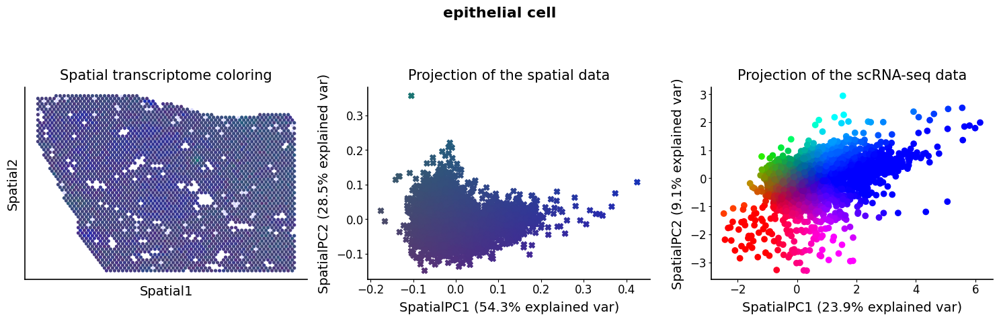

Genes associated with SpatialPC1

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

MT-ND3, MT-ND4, MT-CO2, MT-CO3, MT-ATP6, MT-RNR2, MT-ND4L, MT-ND5, MT-ND1, MT-CO1, MT-ND2, MT-ND6, MTATP6P1, 
MT-CYB, MT-RNR1, MALAT1, MT-ATP8, NEAT1, HSPA1B, HSPA1A, PNISR, CYP4F8, LUC7L3, NKTR, MIR23AHG, CLU, FADS2, SEMG1, 
CD9, HLA-C, SEMG2, OFD1, ANKRD36B, OGT, HLA-A, PTGS2, ITM2B, PSAP, CD74, HSP90B1, CCDC18-AS1, CLDN3, LAPTM4A, B2M, 
WFDC2, SSR4, EGR1, PGGHG, PIP, CD81

---------------------------------------------------------------------------------------

Antigen processing and presentation*, Endosomal/vacuolar pathway*, BDNF signaling pathway*, Immunoregulatory 
interactions between a lymphoid and a non-lymphoid cell*, Nef-mediated downregulation of MHC class I complex cell 
surface expression*, Amyloids*, CTL mediated immune response against target cells*, Interferon alpha/beta 
signaling*, CD8/T cell receptor downstream pathway, Protein processing in the endoplasmic reticulum

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

PPDPF, HELB, ADA2, RAB8B, TJP3, ZNF14, AP3B1, CARD8, ACSS1, ANKRA2, RUSC1, PPP2R3C, NABP1, PPID, METTL21C, BHLHE41,
EML2-AS1, LINC00539, SDS, RPL7P16, LTBP4, SPRYD4, CXorf38, RGS10, SFN, IGKC, MXRA8, LYAR, APOLD1, NLRC4, PRKAA1, 
CTB-3M24.2, PROX1, PITPNA, C9orf24, LIMK2, HIGD2B, TENT4B, RGCC, F2R, CNPPD1, BTLA, STAT5A, PAWR, LINS1, SPOCK3, 
SAA2, IPCEF1, RP11-822P4.2, DIDO1

---------------------------------------------------------------------------------------

PI3K/PLC/TRK pathway, p53 signaling pathway, LKB1 signaling events, Regular glucocorticoid receptor pathway, NOD 
signaling pathway, cAMP receptor, G-protein-independent pathways inferred from amoeba model, Rheb GTPase activity 
by AMPK regulation, Second messenger role in netrin-1 signaling, Ethanol oxidation, Reversal of insulin resistance 
by leptin

Genes associated with SpatialPC2

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

MT-ND3, MT-RNR1, KRT5, MALAT1, MT-ATP8, MTATP6P1, MT-ATP6, CXCL14, HCAR2, NEAT1, KRT17, CFH, MT-CO2, MT-CO3, 
MT-ND1, MT-RNR2, MT-ND2, MT-ND4, MT-CYB, OGT, MIR205HG, ANKRD36B, DEFB1, MT-ND4L, CCN2, EFEMP1, SLC14A1, MT-ND6, 
PLAU, KRT15, SFRP1, MT-ND5, GJA1, PMAIP1, SPRY1, TM4SF1, DST, TNC, VCAN, PITX1, TSPAN8, MT-CO1, PRAC1, CXCL8, AXL, 
ST6GAL1, HCAR3, S100A2, HES4, RP11-138A9.2

---------------------------------------------------------------------------------------

FRA pathway, TAp63 pathway, Interleukin-4 regulation of apoptosis, AP-1 transcription factor network, Regular 
glucocorticoid receptor pathway, Corticotropin releasing hormone pathway, TSH regulation of gene expression, 
TGF-beta regulation of extracellular matrix, p53 signaling pathway, Beta-3 integrin cell surface interactions

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

RPL41, PPDPF, EEF1A1, GSTP1, AKR1B1, FTH1, GAPDH, RPS10, MIF, RPS12, RPL10, PRPS2, TMSB4X, CD24, TPI1, RPL36, 
COX7C, RPL30, RPL15, RPL19, RPL3, RPS25, RPL26, RPL8, HSP90AB1, GSTM3, RPS6, POLR2L, NACA, RPS28, RPL13, RPL39, 
SERF2, PRDX2, SRP14, CHCHD2, RPS26, RPL21, RPL28, RPL10A, RPL7A, FKBP1A, PRDX1, RPL11, ANXA2, RPS4X, RPS13, RPS3A, 
RPL23A, RPL24

---------------------------------------------------------------------------------------

Influenza viral RNA transcription and replication*, Translation*, Cytoplasmic ribosomal proteins*, Influenza 
infection*, Protein metabolism*, Cap-dependent translation initiation*, Disease*, Gene expression*, Activation of 
mRNA upon binding of the cap-binding complex and eIFs, and subsequent binding to 43S*, T cell receptor regulation 
of apoptosis*

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/cmap2d/util.py:32: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  bary_coords = la.lstsq(self._a,b)[0]


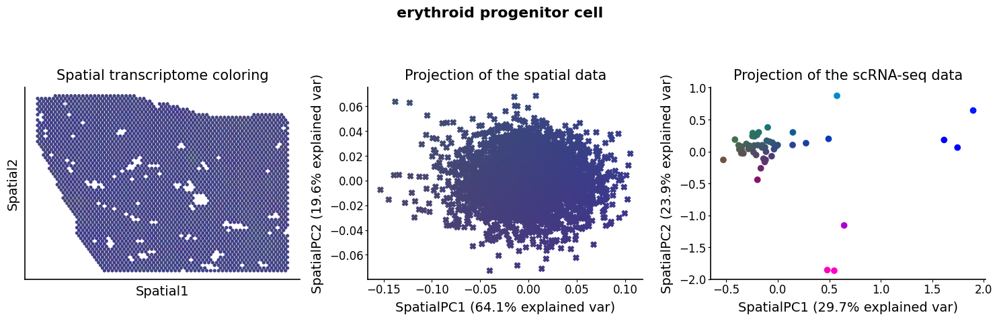

Genes associated with SpatialPC1

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

HSP90B1, SEMG2, CD63, PIP, LAPTM4A, CLU, SEMG1, FADS2, MFSD2A, CD81, CLDN3, PSAP, SERPINA5, NUCB2, HSPA5, IQGAP2, 
CGRRF1, SLC26A3, LPL, ENPP3, CALM1, DPM1, HMGN2, ABCG2, MT2A, CST3, BIRC6, FXR1, GSTM3, LNPEP, LIFR, M6PR, CD9, 
FAM3D, PTGS2, PGC, ELOVL5, APP, EEF1B2, CD24, APLP2, SPAG9, SSR4, SOCS2, ITM2B, MUC6, P4HTM, ITGB8, TOB1, TMEM87B

---------------------------------------------------------------------------------------

Response to elevated platelet cytosolic calcium*, Platelet activation, signaling and aggregation*, Amyloids*, 
Oncostatin M*, Hemostasis pathway*, Lysosome, Alpha-linolenic (omega3) and linoleic (omega6) acid metabolism, 
Activation of chaperones by ATF6 alpha, Biosynthesis of unsaturated fatty acids, Disease

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

HBB, HBA2, HBA1, GYPC, YBX3, SERF2, UBB, ATP5F1E, FAM210B, HBQ1, SLC25A37, UBA52, ALAS2, MYL6, RIOK3, SNCA, FTL, 
SLC4A1, EPB41, LGALS3, TRIM58, GSPT1, PIP4K2A, FBXO9, DCAF12, GYPB, TENT5C, UCP2, WNK1, HBM, CUL4A, PCGF5, FDX1, 
CA1, PTMS, CHPT1, TSC22D3, EPB42, TNS1, BPGM, RGS10, PPP1CB, AHSP, ODC1, IGFBP7, FAM104A, HEMGN, MARK3, PRDX6, RPA1

---------------------------------------------------------------------------------------

Alpha-hemoglobin stabilizing enzyme (AHSP) pathway*, Oxygen/carbon dioxide exchange in erythrocytes*, Malaria*, 
TGF-beta receptor activation of SMADs*, Downregulation of ERBB4 signaling*, Nitric oxide effects*, IRAK2-mediated 
activation of TAK1 complex*, Fanconi anemia pathway regulation*, Vitamin B12 metabolism*, Assembly of HIV virion*

Genes associated with SpatialPC2

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

ECI2, XPO1, HBB, ADIRF, PAEP, WFDC2, THAP6, MRPL44, SRI, INTS14, LMO2, API5, SEPTIN6, IFI35, ERCC3, RLF, PIH1D1, 
UTP18, SLC20A2, NBN, ZNF14, UBAP2L, NRP1, TIMP2, TSNAX, MYL9, CDC42SE2, COQ5, MDK, CST4, HBA2, PRDX1, CFLAR, RPL23,
AGR2, GYPC, RPL7, SPINK2, ACOX3, PIP, RPL37A, FAM107B, RRM1, RPL21, EXOC1, FAM3D, SLC44A2, IL1RL1, ECHS1, ACLY

---------------------------------------------------------------------------------------

Influenza infection*, Cap-dependent translation initiation*, Cytoplasmic ribosomal proteins*, Fatty acid 
metabolism*, Influenza viral RNA transcription and replication*, Malaria*, Selenium pathway, Alpha-hemoglobin 
stabilizing enzyme (AHSP) pathway, Translation, Peroxisome

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

MT-ND3, MT-CO1, GALM, FOSB, MT-RNR1, SAT1, MT-RNR2, MALAT1, MT-ND6, MT-ATP6, MT-CO2, MT-ND4, CLIP1, ZRANB2, PDE7B, 
PLK3, ELF5, RIC3, MT-ATP8, HSPB1, MT-ND1, MT-CO3, MT-ND4L, NEAT1, MT-ND2, MTATP6P1, MT-ND5, ASH1L, CYP4F8, DNAJB1, 
FUS, PNISR, HSP90AA1, DDIT4, PDK4, AAK1, MT-CYB, KLF6, SRSF7, SAFB2, SERPINH1, FOS, ZNF638, ARRDC3, HSPH1, 
KCNQ1OT1, HSPE1, H3-3B, MED23, CHD9

---------------------------------------------------------------------------------------

BDNF signaling pathway*, Mitochondrial pathway of apoptosis: caspases, Hypoxia and p53 in the cardiovascular 
system, Corticotropin releasing hormone pathway, T cell receptor regulation of apoptosis, Protein processing in the
endoplasmic reticulum, TGF-beta signaling pathway, Telomerase regulation, Polo-like kinase 3 (PLK3) pathway, 
Cytochrome P450 metabolism of eicosanoids

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/cmap2d/util.py:32: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  bary_coords = la.lstsq(self._a,b)[0]


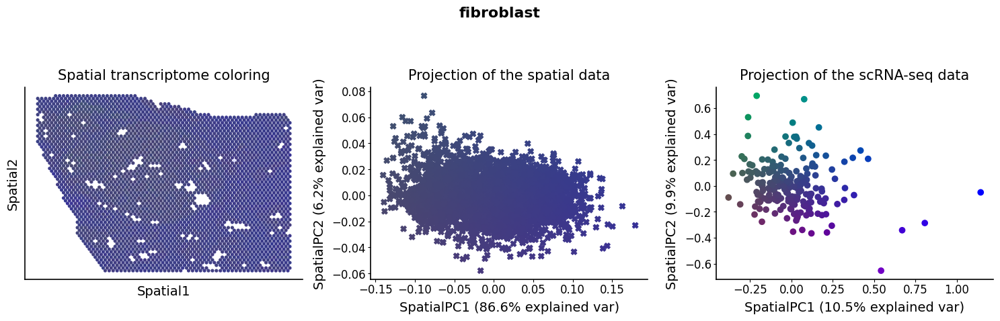

Genes associated with SpatialPC1

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

MT-ATP6, MT-ND4L, MT-ND4, MTATP6P1, MT-CYB, MT-ND3, MT-ND5, MT-ND1, MT-CO1, MT-CO3, MT-CO2, MT-ND2, MT-RNR1, 
MT-ND6, MT-RNR2, GPSM3, NPY, CNR1, MSLN, MT-ATP8, LGI4, CRISPLD2, SPOCK1, RGS5_ENSG00000143248, TM4SF1, TACC1, 
NEAT1, IGFBP5, RIOK3, EBF1, ASPN, ARHGAP26, NADSYN1, NOSTRIN, DCAF1, PCNX1, ENTPD4, SMAD2, NR4A1, PTPRG, SLC7A2, 
PPP3CC, ERRFI1, BTG2, DCLK1, BCL6, EGR3, THBS1, IGFBP6, C1R

---------------------------------------------------------------------------------------

Ghrelin-mediated regulation of food intake and energy homeostasis, Insulin-like growth factor (IGF) activity 
regulation by insulin-like growth factor binding proteins (IGFBPs), Inhibition of activated T cell apoptosis by 
neuropeptides VIP and PACAP, MEF2D role in T cell apoptosis, BDNF signaling pathway, NOSTRIN-mediated endothelial 
NOS trafficking, T cell receptor regulation of apoptosis, Anandamide metabolism, BAD activation and translocation 
to mitochondria, TGF-beta regulation of skeletal system development

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

HSPA1A, RPS3, RACK1, RPS19, ISG20, CD48, CD69, CXCR4, LINC01871, ARHGAP9, RPS3A, NPM1, HSPA1B, RPS27A, FYB1, 
ARHGDIB, ACAP1, CYTIP, TMEM71, TYROBP, HSP90AB1, SRGN, IL7R, EVI2B, BAZ2B, RPL21, PTGER4, CD2, LDHB, RPS2, RPS15A, 
COTL1, RPL10A, CD3E, CORO1A, ICOS, IPCEF1, IL2RB, CD96, GTPBP10, IQCB1, RPS23, RPL36, RPS4X, RPL19, RPL35A, CCL5, 
COX17, H1-3, KLRC1

---------------------------------------------------------------------------------------

Influenza infection*, Cytoplasmic ribosomal proteins*, Influenza viral RNA transcription and replication*, 
Translation*, Disease*, Activation of mRNA upon binding of the cap-binding complex and eIFs, and subsequent binding
to 43S*, Protein metabolism*, Gene expression*, Interleukin-2 signaling pathway*, Cap-dependent translation 
initiation*

Genes associated with SpatialPC2

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

TNXB, SPARCL1, TIMP2, PSAP, MMP2, TIMP3, LAMA2, MFGE8, HSP90B1, EDNRB, LIFR, COL14A1, F8, HLA-DPA1, GSN, APP, 
PDGFRB, TFPI, SLIT3, SCN7A, PCOLCE2, MARCKS, KANK3, ESAM, FBXO42, PLPP3, CHRDL1, HLA-DRA, SMC5, SCARA5, FXYD5, FN1,
CCL26, FBLN1, SPON2, AEBP1, SNHG14, UTRN, CDA, CLEC14A, EPAS1, C7, ANGPTL1, SERPING1, SP3, CPB1, NSD1, MFAP4, 
ADGRF5, CAVIN2

---------------------------------------------------------------------------------------

Inhibition of matrix metalloproteinases*, Response to elevated platelet cytosolic calcium*, Complement and 
coagulation cascades*, Matrix metalloproteinases*, Interleukin-4 regulation of apoptosis*, Fibrin clot formation 
(clotting cascade)*, Extracellular matrix organization*, Oncostatin M*, Pathways in cancer*, Hemostasis pathway*

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

RPL3, RPS3A, RPS24, NPM1, JUNB, RPL30, MT-RNR1, RPL7A, RPL9, MIR205HG, RPL35A, RPS23, RPL37, CLCA2, EDF1, RPL5, 
SOCS3, IER2, RPL32, MT-RNR2, S100A14, RPS3, RPL24, RPS27A, RPS13, RPS21, RPS16, NACA, S100A2, RPL23A, GDF15, RPS12,
RPS5, PTMS, FAU, MT1X, MT-ATP6, MT-ND3, MT-CYB, RPL15, RPS4X, RPL41, RPL8, RPL23, RPS27, RPL6, RPL10A, ZCCHC8, 
RPL34, UQCRH

---------------------------------------------------------------------------------------

Cytoplasmic ribosomal proteins*, Influenza viral RNA transcription and replication*, Influenza infection*, 
Translation*, Protein metabolism*, Disease*, Cap-dependent translation initiation*, Gene expression*, Activation of
mRNA upon binding of the cap-binding complex and eIFs, and subsequent binding to 43S*, T cell receptor regulation 
of apoptosis*

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/cmap2d/util.py:32: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  bary_coords = la.lstsq(self._a,b)[0]


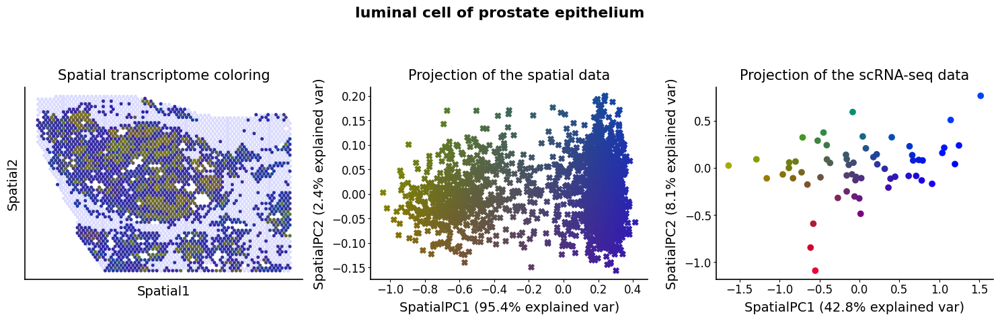

Genes associated with SpatialPC1

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

TXK, NKX2-3, PRELP, PEBP1P3, HBD, CA3, TMIGD2, BIN2, EREG, AC007278.3, NLRC3, MMS22L, RP11-354M20.3, KLRC1, CD69, 
CYTIP, SFRP4, FILIP1, TFPI, GPR68, CD48, CSF3, LMOD1, GZMK, HECW1, MKI67, LSP1, RP11-1143G9.4, CHI3L2, ARHGAP45, 
CRTAM, CD8B, CCR5, GPR22, LTF, DEFB126, SPAG6, CCL3L1, CCDC141, NUP93, BTNL9, RP11-347P5.1, MEI1, LAIR1, COL12A1, 
TTLL3, CTSW, THEMIS, TUBA3D, TBXAS1

---------------------------------------------------------------------------------------

Interleukin-2 signaling pathway, Immunoregulatory interactions between a lymphoid and a non-lymphoid cell, Malaria,
Binding of chemokines to chemokine receptors, Interleukin-12-mediated signaling events, Cytochrome P450 metabolism 
of eicosanoids, Extrinsic pathway, HIV infection, T cell receptor regulation of apoptosis, Nef-mediated CD8 
downregulation

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

CHCHD2, RPL23A, RPL10A, RPL3, RPLP0, NUPR1, RPL21, RPL27A, PRDX1, EEF1A1, RPL27, KRT18, RPS3A, RPL37, UBC, RPS14, 
RPSA, EDF1, DSTN, RPL18A, RPL9, CD81, TPT1, SRP14, RPL7, RACK1, RPL15, RPS29, RPL38, PRDX2, RPL37A, BASP1, RPS11, 
RPLP2, H2AC6, RPL31, RPS2, RPS8, RPS9, NPM1, PTMA, EIF1, FKBP1A, RPS16, H3-3B, RPL23, HMGN2, RPS27L, ECHS1, DDX5

---------------------------------------------------------------------------------------

Translation*, Cytoplasmic ribosomal proteins*, Influenza viral RNA transcription and replication*, Influenza 
infection*, Protein metabolism*, Cap-dependent translation initiation*, Disease*, Gene expression*, Activation of 
mRNA upon binding of the cap-binding complex and eIFs, and subsequent binding to 43S*, T cell receptor regulation 
of apoptosis*

Genes associated with SpatialPC2

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

CHD7, MT-ATP8, MT-RNR2, KIDINS220, RALGAPA1, CEP95, ATXN1, ANAPC4, RNF19A, FAF2, PHLDB2, NOL8, KIAA1109, MT-RNR1, 
ELN, SACM1L, MALAT1, MT-ND5, MT-CO3, ARGLU1, OGFRL1, RAE1, TTLL3, RASA2, SMCHD1, MT-ATP6, NKX2-3, MTATP6P1, MT-ND2,
NR2F2, NCOR1, RALGAPA2, MT-ND4, ANKRD12, SLC25A46, NCOA3, ECD, NGLY1, ITGB1, BHLHE40, CASP2, DSP, ARID1B, UBE3A, 
RP11-463O12.5, KMT2A, PUM2, KDM5A, ATRX, MT-ND4L

---------------------------------------------------------------------------------------

BMAL1-CLOCK/NPAS2 activates circadian expression, Circadian rhythm, Transcriptional regulation of white adipocyte 
differentiation, Androgen receptor signaling, proteolysis, and transcription regulation, Estrogen receptor 
transcription factor targets, Control of gene expression by vitamin D receptor, RORA activates circadian 
expression, HNF3A pathway, Validated nuclear estrogen receptor alpha network, Telomerase regulation

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

STAT4, PDE7B, SERPINA1, FAM3D, PTGER4, MORN5, PRPS2, SELP, ST3GAL1-DT, RP11-37C7.3, TCN1, SEMG1, SEMG2, LAS1L, PGC,
GAL, CDO1, UCP2, PATE4, APIP, CA2, NPW, TESC, PTGS2, DCAF1, EBI3, NRP2, MS4A6A, CD247, ELF5, NAP1L3, PILRA, WIPF1, 
RBBP7, AKR1B1, TRG-AS1, CYRIB, RBMS3, GP2, NUCB2, YIPF5, RDH16, BABAM2, CDA, CENPF, SEC61G, MED12, MYD88, COQ10B, 
CYFIP2

---------------------------------------------------------------------------------------

Interleukin-5 regulation of apoptosis, NO2-dependent IL-12 pathway in NK cells, Eicosanoid metabolism, Sulfur amino
acid metabolism, Interleukin-27-mediated signaling events, Prostaglandin biosynthesis and regulation, Cysteine and 
methionine metabolism, BDNF signaling pathway, Interleukin-12/STAT4 pathway, Malaria

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/cmap2d/util.py:32: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  bary_coords = la.lstsq(self._a,b)[0]


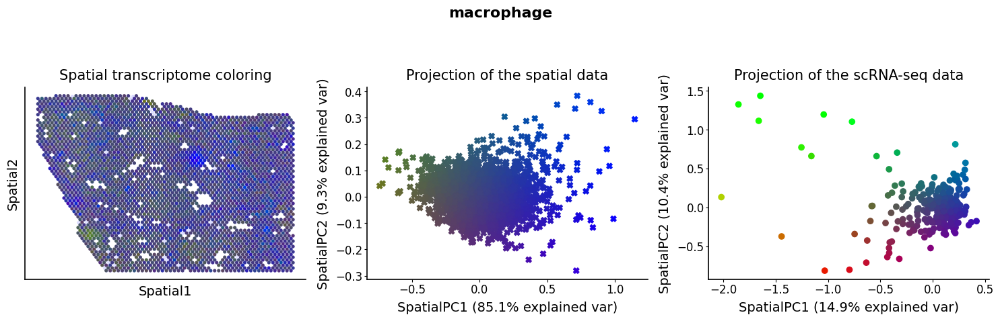

Genes associated with SpatialPC1

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

CD74, HLA-DPA1, HLA-DRA, HLA-DRB1, HLA-DPB1, C1QC, VSIR, HCLS1, TYROBP, TPT1, HLA-DMA, ITM2B, AIF1, RPS13, MS4A6A, 
RGS10, HLA-E, EIF1, C1QA, C1QB, SRGN, CSF1R, NPC2, RACK1, IL18, RPS16, SMAP2, FCGR2A, C3AR1, WASF2, PTMA, RPS20, 
CYBA, CALHM6, SAT1, IFNGR1, GIMAP4, RPL38, TBXAS1, LST1, LY86, RPS19, RPL27A, RPL23, RPS2, ITGB2, RPL13A, RGS1, 
RPL27, DUSP1

---------------------------------------------------------------------------------------

Cytoplasmic ribosomal proteins*, Leishmaniasis*, Influenza viral RNA transcription and replication*, Influenza 
infection*, Translation*, Systemic lupus erythematosus*, Phagosome*, Allograft rejection*, Viral myocarditis*, 
Graft-versus-host disease*

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

PIP, CD24, SEMG2, SEMG1, WFDC2, CLU, FAM3D, NUPR1, NUCB2, BEX3, FDX1, IL1RL1, SERPINA5, CDO1, GSTP1, PATE4, CLDN3, 
AGR2, TBX3, PRPS2, AQP2, GATA2, ABCG2, CST4, CYP4F8, MSLN, SLPI, LAPTM4A, PGC, ID4, MIF, CD9, KRT18, ENPP3, MFSD2A,
CRYAB, TMEM101, ADIRF, PPP1R1B, FADS2, KRT8, SPINK2, SEC11C, PATE1, PHGDH, SLC26A3, ID1, PAEP, C12orf75, RBBP7

---------------------------------------------------------------------------------------

FSH regulation of apoptosis, HIF-1 transcriptional activity in hypoxia, Abacavir transmembrane transport, 
Cytochrome P450 metabolism of eicosanoids, FOSB gene expression and drug abuse, Signaling events mediated by HDAC 
class I, Multi-drug resistance factors, Arachidonate epoxygenase/epoxide hydrolase pathway, SLC26 family 
multifunctional anion exchangers, Response to elevated platelet cytosolic calcium

Genes associated with SpatialPC2

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

PIP, FAM3D, SEMG2, CD24, SEMG1, CLU, SERPINA5, WFDC2, PRPS2, PATE4, IL1RL1, CDO1, NUCB2, GSTP1, KRT18, BEX3, KRT8, 
TBX3, AGR2, FDX1, GATA2, PHGDH, MSLN, SLC26A3, PGC, CD9, ENPP3, LAPTM4A, GSTM3, ABCG2, CYP4F8, CLDN3, CRABP2, SLPI,
MFSD2A, PATE1, ID4, PAEP, FADS2, ZFHX4, AQP2, SFRP2, GNG11, CLDN2, C10orf99, PAWR, ELF5, CRYAB, PPP1R1B, LTF

---------------------------------------------------------------------------------------

BDNF signaling pathway, FSH regulation of apoptosis, Tight junction interactions, TGF-beta regulation of 
extracellular matrix, Diurnally regulated genes with circadian orthologs, Aquaporin-mediated transport, Glutathione
metabolism, Amyloids, Oncostatin M, Metapathway biotransformation

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

MT-ATP6, MTATP6P1, MT-ND1, MT-CO3, MT-ND4, MT-CO2, MT-CO1, MT-RNR1, MT-ND3, MT-ND2, MT-RNR2, MT-CYB, MT-ND4L, 
MT-ND5, NEAT1, SOD2, MALAT1, LAPTM5, CCNL1, SRGN, HLA-A, FOSB, MCL1, HLA-B, CTSB, B2M, NR4A1, NAMPT, C5AR1, CTSS, 
TAMALIN, RGS1, RASGEF1B, MT-ND6, FTL, CFLAR, IER3, DDX5, FOS, ZFP36, TYROBP, CD74, GNA13, LITAF, BTG2, GPR183, 
ZFP36L1, NFKBIZ, MS4A7, DUSP1

---------------------------------------------------------------------------------------

Endosomal/vacuolar pathway*, Antigen processing and presentation*, Interleukin-2 signaling pathway*, T cell 
receptor regulation of apoptosis*, Interleukin-1 regulation of extracellular matrix*, AP-1 transcription factor 
network*, Antigen processing: cross presentation*, BDNF signaling pathway*, Adaptive immune system*, 
Immunoregulatory interactions between a lymphoid and a non-lymphoid cell*

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/cmap2d/util.py:32: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  bary_coords = la.lstsq(self._a,b)[0]


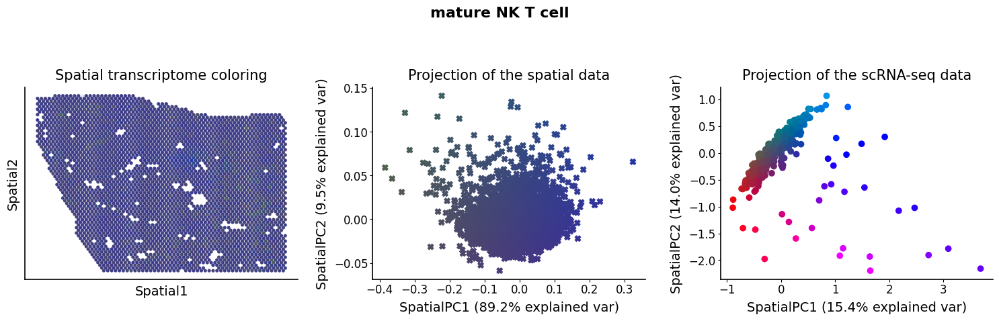

Genes associated with SpatialPC1

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

B2M, ACTG1, RPS3A, MT-CO1, MT-RNR2, MT-ATP8, RPL3, RPS9, TMSB4X, FOSB, MT-CO2, HLA-B, RPL19, RPS11, HLA-A, ATP5F1E,
MT-CYB, ARHGDIB, RPL7A, RPS29, RPL13A, HLA-C, MALAT1, PTMA, MT-ND5, RPS27, NEAT1, RPLP2, RPL27A, ACTB, SH3BGRL3, 
FTH1, CALM1, CST7, DUSP1, PPP2R5C, MT-ND4L, TOB1, MT-ND1, RPL9, RPS13, SYNE2, ISG20, RPS12, RPL35A, MT-ND2, RPL12, 
MT-CO3, MIER1, MYL6

---------------------------------------------------------------------------------------

Cytoplasmic ribosomal proteins*, Influenza viral RNA transcription and replication*, Influenza infection*, 
Translation*, Disease*, Protein metabolism*, Cap-dependent translation initiation*, Activation of mRNA upon binding
of the cap-binding complex and eIFs, and subsequent binding to 43S*, Gene expression*, Endosomal/vacuolar pathway*

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

HSPA1A, HSPA1B, SEMG2, FRMD4B, PRPS2, PIP, Metazoa_SRP_ENSG00000274008, SEMG1, CYP4F8, LTA, FAM43A, PLPP1, KANSL3, 
PLCB1, GPRIN3, SETD2, ZNF506, PDK4, GPM6B, ABCG2, AKAP5, SLF2, MSH3, KRCC1, FLNB, MGAM, LEO1, SERPINA5, CDA, CD24, 
NUP42, GIMAP8, NUPR1, HES4, ALDH3A2, PEBP1P3, TCN1, LCN2, TCIM, CEACAM8, MXRA5, HBA2, S100A8, NLRC4, BRIX1, LTF, 
PGC, ATXN2, STAT6, RECQL5

---------------------------------------------------------------------------------------

Apoptosis modulation by HSP70, Oncostatin M, Fluoropyrimidine activity, Lysine degradation, Amyloids, Pyruvate 
metabolism, Vitamin B12 metabolism, G-protein signaling through tubby proteins, Abacavir transmembrane transport, 
Cytochrome P450 metabolism of eicosanoids

Genes associated with SpatialPC2

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

RGS10, BLK, HLA-DRA, NAPSB, IGHD, LINC01781, IGHM, MEF2C, TCF4, MS4A1, CR2, VPREB3, PAX5, FCGR2B, HECW2-AS1, MTIF2,
FCER2, CAMK4, RNASE6, SIRPG, LINC01857, MARCHF1, RETREG1, BLNK, CHMP2B, KIFBP, GPX2, QRSL1, CASP6, ACTA2, HTRA1, 
PCID2, SAA1, TBX3, LINC00239, RP1-47M23.3, LINC01882, LINS1, SLC26A3, UTP18, TTC5, NBL1, RP5-1171I10.5, DALRD3, 
SELENOP, SNN, WFDC21P, RNVU1-15, DNASE1L3, CNR1

---------------------------------------------------------------------------------------

Antigen-activated B-cell receptor generation of second messengers*, B lymphocyte cell surface molecules*, 
Hematopoietic cell lineage*, Signaling by the B cell receptor (BCR), PGC-1a regulation, CDO in myogenesis, Immune 
system, Adaptive immune system, Signaling events mediated by HDAC class II, Energy metabolism

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

FOSB, ATP5F1E, MALAT1, TMSB4X, LCP1, CALM1, CYBA, MT-ND5, POTEI, B2M, PTMA, CD63, HLA-A, FOS, CST7, DBI, ACTG1, 
HLA-B, ARHGDIB, TMSB10, MT-CO2, RPS11, MT-RNR2, CCL5, FTL, MT-CO1, MT-ND4L, KLRF1, PIK3CG, RCAN3, KLRD1, PSAP, 
ACTB, PPP2R5C, CASP4LP, RPL23A, PTPN4, TRIM22, CXCR4, GNAI2, SRSF7, MT-ATP8, RPS27, CDC42SE1, HSPH1, RPS29, ISG20, 
RPS13, SPON2, RPL27A

---------------------------------------------------------------------------------------

Disease*, Cytoplasmic ribosomal proteins*, Leukocyte transendothelial migration*, Influenza viral RNA transcription
and replication*, Endosomal/vacuolar pathway*, Influenza infection*, T cell receptor regulation of apoptosis*, 
Translation*, Pertussis toxin-insensitive CCR5 signaling in macrophage*, Platelet activation, signaling and 
aggregation*

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/cmap2d/util.py:32: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  bary_coords = la.lstsq(self._a,b)[0]


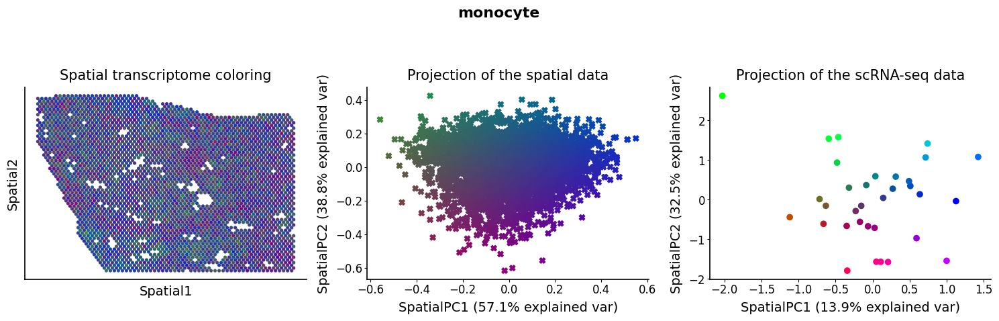

Genes associated with SpatialPC1

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

HOOK3, POLR2B, TAOK1, USP10, S100A9, S100P, TMUB2, FCGR3B, HLA-C, CYYR1, CRABP2, EFNB2, LCN6, KIAA0040, SOX4, WAS, 
POLR2L, RBMS1, TLR2, DPF2, COG7, AGTRAP, UBE2H, SYNE1, CPQ, CTSH, RHOT2, CXCL1, MTERF3, MCEMP1, VCAN, GTF3C1, 
CARS1, IFITM2, MARCKS, THBS1, THBD, RAC2, SEMG1, CFD, CYFIP2, TNPO3, UBE3B, GAPVD1, COX17, TTC37, VASP, DYNLT3, 
WWTR1, SUGP2

---------------------------------------------------------------------------------------

Endogenous Toll-like receptor signaling*, Fc gamma receptor-mediated phagocytosis*, Oncostatin M*, BDNF signaling 
pathway, Viral messenger RNA biosynthesis, Phagosome, Integrin signaling pathway, Immune system, ID regulation of 
gene expression, Regulatory RNA pathways

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

CREM, SSH2, RASGEF1B, TNFAIP3, LPIN2, LINC00649, H3-3B, GPR65, PELI1, SP100, MBNL1, RANBP2, MT-ND5, DDX5, ID2, UTY,
MAN2A1, RP11-147L13.11, PLXDC2, CACYBP, CCNL1, TIPARP, MALAT1, C3AR1, BIRC2, PLEKHB2, LPAR6, REL, IRS2, TRA2B, 
SLC7A5, TNKS2, CHD2, HSPA6, JAM2, RLIM, TBC1D23, PIK3IP1, WAC, NOP58, GEM, MT-ND4L, DAP3, RCOR3, ANXA1, DUSP4, 
SRRM2, TACC1, P2RY13, CEP350

---------------------------------------------------------------------------------------

Interleukin-2 signaling pathway*, Interleukin-5 regulation of apoptosis, Nucleotide-like (purinergic) G-protein 
coupled receptors, TNF-alpha signaling pathway, Tumor necrosis factor (TNF) pathway, CD40/CD40L signaling, Immune 
system, GPCR ligand binding, Class A GPCRs (rhodopsin-like), Interleukin-1 signaling pathway

Genes associated with SpatialPC2

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

ADGRF1, ZFAND2A, EPRS1, CEP350, RCOR3, CITED2, VPS41, RBM25, GLE1, LINC02712, HPS1, FDX1, PLAU, FASLG, GRWD1, 
CLCA2, SUSD5, FLT1, ADAMTS9, ALDOC, THAP6, TXLNG, NT5C3AP2, CLSTN2, ACTRT3, PIK3R3, MROCKI, COMMD2, SCAMP1, TUFT1, 
UBXN2A, RBBP7, PLK2, AAAS, SIAH1, CCDC91, NOP58, HSPE1, PPP1R10, CNPPD1, TBC1D23, CDC5L, WAC, CBLL1, GADD45G, 
NUP85, PAPOLG, CERT1, HSPA5, JAM2

---------------------------------------------------------------------------------------

Rev-mediated nuclear export of HIV-1 RNA, HIF-2-alpha transcription factor network, FRA pathway, Transport of 
mature mRNAs derived from intronless transcripts, Alpha-M beta-2 integrin signaling, Hexose transport, Interactions
of HIV Vpr protein with host cellular proteins, EGFR1 pathway, Non-coding RNA metabolism, Transport of mature 
transcript to cytoplasm

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

FCER1G, TMSB4X, LAPTM5, FCGR2A, S100A11, HLA-DPA1, GAPDH, EEF1D, HLA-DRA, HLA-DMA, RPS3A, HLA-DPB1, FGL2, PIP4K2A, 
RPS12, RPL8, HLA-DMB, DOCK10, GLIPR1, RPS29, LYZ, NPM1, C1QB, MYO1F, RPL23A, CD74, GNS, TMSB4XP2, CKLF, RPL19, 
ACTG1, AIF1, COX4I1, CALHM6, PIK3R1, RND3, WNK1, RPL32, KCTD12, RPS26, RPS20, CTSB, RPLP1, LY86, LAT2, RNASE6, 
ACTB, RB1, TPI1, MYD88

---------------------------------------------------------------------------------------

Translation*, Cytoplasmic ribosomal proteins*, Influenza viral RNA transcription and replication*, Influenza 
infection*, Asthma*, Viral myocarditis*, Leishmaniasis*, Disease*, Protein metabolism*, Antigen processing and 
presentation*

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/cmap2d/util.py:32: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  bary_coords = la.lstsq(self._a,b)[0]


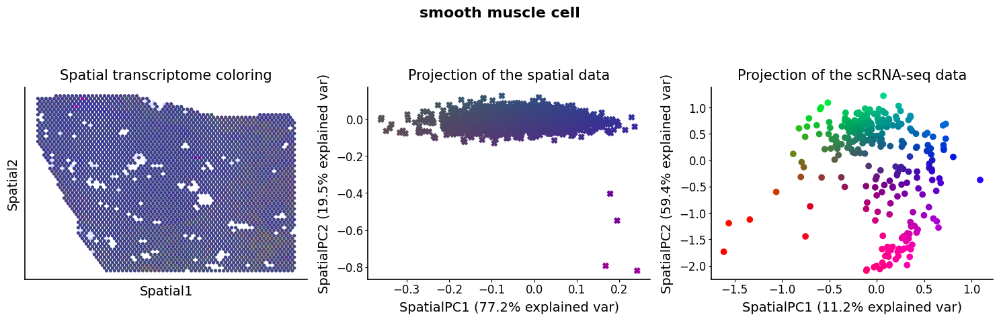

Genes associated with SpatialPC1

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

IGFBP6, RPS15A, RPL11, RPS18, NR2F1, RPS12, RPS8, RPL13, RPS7, RARRES2, RPL28, RPL29, TPT1, RPL30, RPL32, RPL26, 
RPS15, NDRG2, IFITM1, RACK1, RPS9, RPL10, RPS2, STEAP4, RPL37, RPL12, NBL1, RPS13, RPS3A, RPS27A, PTH1R, RPL35A, 
RPL18A, RPS19, GPM6B, RPL18, RPL3, PMP22, ARHGDIB, RPL39, RPS3, RPS4X, BST2, MARCKS, RPS5, RPL21, ACVRL1, BTG1, 
RPL41, HLA-A

---------------------------------------------------------------------------------------

Cytoplasmic ribosomal proteins*, Influenza viral RNA transcription and replication*, Influenza infection*, 
Translation*, Protein metabolism*, Disease*, Gene expression*, Cap-dependent translation initiation*, Activation of
mRNA upon binding of the cap-binding complex and eIFs, and subsequent binding to 43S*, T cell receptor regulation 
of apoptosis*

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

MT-ND1, MT-RNR2, MT-RNR1, MT-ND5, MT-CYB, MT-ND4, MT-ND4L, MT-ATP6, MT-CO3, MT-ND2, MT-ND3, MT-CO1, MTATP6P1, MCAM,
CARMN, MT-CO2, MYH11, FLNA, MT-ATP8, SYNM, MALAT1, MT-ND6, SORBS2, ACTN1, DSTN, KCNAB1, PLN, ALCAM, TPM1, CASQ2, 
CNN1, FILIP1, MSRB3, NTRK2, SLMAP, TPM2, PATJ, EDIL3, NEXN, ACTA2, IRAG1, SNHG14, LMOD1, FHL1, MYL9, COL14A1, MYL6,
CA12, FOXI1, DMRT2

---------------------------------------------------------------------------------------

Smooth muscle contraction*, Muscle contraction*, Striated muscle contraction*, Sema4D in semaphorin signaling*, 
Vascular smooth muscle contraction*, Semaphorin interactions*, Cell-extracellular matrix interactions*, Dilated 
cardiomyopathy, Focal adhesion, FSH regulation of apoptosis

Genes associated with SpatialPC2

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

DSTN, MYL9, TAGLN, FLNA, NDUFA4, PLN, SOD3, NEXN, LMOD1, TPM2, ACTA2, FHL5, ADIRF, NTRK2, CNN1, MCAM, C12orf75, 
MYL6, MYH11, FHL1, TPM1, PLAC9, RERGL, CSRP2, ACTN1, CRYAB, CAVIN3, KCNAB1, SELENOM, CASQ2, CRIP1, ACTB, RCAN2, 
SUSD5, ACTG2, LINC01088, PRELP, PPP1R14A, CPE, SNCG, PALLD, LPP, MFGE8, S100A6, IRAG1, HSPB7, NOTCH3, MT1X, LTBP1, 
AP000892.6

---------------------------------------------------------------------------------------

Smooth muscle contraction*, Muscle contraction*, FSH regulation of apoptosis*, Vascular smooth muscle contraction*,
Striated muscle contraction*, Sema4D in semaphorin signaling*, Dilated cardiomyopathy*, Integrin-linked kinase 
signaling*, Focal adhesion*, Tight junction*

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

TXNIP, TCF4, LIFR, NEDD9, EGFL7, PODXL, PECAM1, ITGA6, ADGRF5, CAVIN2, TAMALIN, SEC14L1, PTPRB, TGFBR2, ADGRL4, 
HLA-E, HLA-A, LDB2, PLVAP, NOSTRIN, SPTBN1, DNAJA1, NOTCH4, FLT1, PCAT19, VWF, S100A10, GIMAP4, HLA-DRA, EPAS1, 
CLEC14A, CD74, MYCT1, FAM107A, SRGN, WWTR1, ACVRL1, ETS1, HLA-B, GNG11, GIMAP7, GALNT15, SHANK3, NRP1, LMO2, 
SLC2A3, CYP26B1, MEIS2, TSPAN14, HLA-DPA1

---------------------------------------------------------------------------------------

Allograft rejection*, Cell adhesion molecules (CAMs)*, Antigen processing and presentation*, Graft-versus-host 
disease*, Type 1 diabetes mellitus*, Autoimmune thyroid disease*, Viral myocarditis*, Endosomal/vacuolar pathway*, 
TGF-beta signaling in gastrointestinal stem cells*, Interferon-gamma signaling pathway*

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/cmap2d/util.py:32: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  bary_coords = la.lstsq(self._a,b)[0]


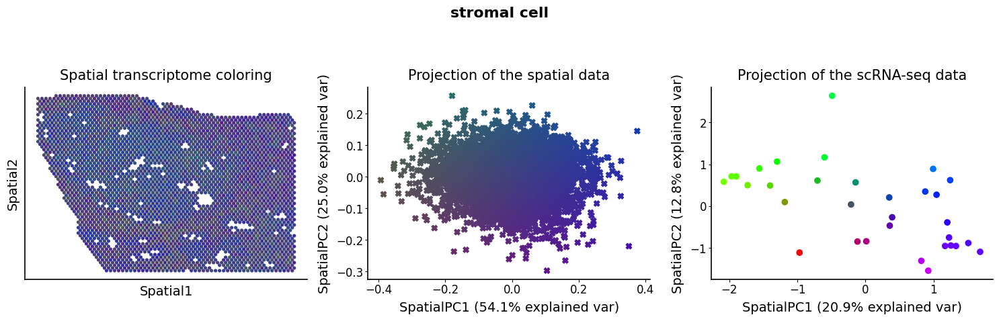

Genes associated with SpatialPC1

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

MT-CO1, MT-CO3, MT-ND6, SEMG1, MT-ND1, MT-ND5, MT-ND2, ITGAL, PAEP, TMCO4, MT-ND4L, MT-ATP8, USP33, MT-CO2, 
ARHGAP45, ADAMTS6, MIS12, GVINP1, ALOX5AP, SLC25A46, LCK, RAB3B, CYP4F8, RPGR, GTF2H1, FAM183A, FAM3D, CAPN5, MUC6,
FAM110C, ENPP3, NDFIP2, EFR3A, PRPS2, ANK3, GCA, HECA, KANSL3, IFNG, MFSD2A, MT-ND4, MT-ND3, CFL2, SEMG2, DENND10, 
PTGER2, CD2, ACSL1, HYDIN, C1QB

---------------------------------------------------------------------------------------

T helper cell surface molecules, Adhesion and diapedesis of granulocytes, Dendritic cells in regulating TH1 and TH2
development, NO2-dependent IL-12 pathway in NK cells, Eicosanoid metabolism, Cell surface interactions at the 
vascular wall, Inflammatory response pathway, Natural killer cell-mediated cytotoxicity, Malaria, SHP2 signaling

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

RPL9, RPL13A, RPL5, RPL15, FOS, JUNB, RPS19, RPS3, RPL27, RPS27, RPLP1, CALM1, S100A6, RPS3A, CD63, RPL18A, RPL7A, 
ACTG1, SERF2, RPS15, IFITM3, ACTB, RPL23, RPL29, RPS9, RPL7, LTBP4, EGR1, ZFP36L1, RPL23A, ISLR, RPS20, SPARCL1, 
RPL3, DUSP1, RPL41, TCF4, RPL35A, RPS23, GAPDH, RPS11, EMP2, EEF1A1, FTL, HINT1, UBC, RPL14, BEX3, RPS13, RPL32

---------------------------------------------------------------------------------------

Cytoplasmic ribosomal proteins*, Influenza viral RNA transcription and replication*, Translation*, Influenza 
infection*, Protein metabolism*, Disease*, Cap-dependent translation initiation*, Gene expression*, Activation of 
mRNA upon binding of the cap-binding complex and eIFs, and subsequent binding to 43S*, T cell receptor regulation 
of apoptosis*

Genes associated with SpatialPC2

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Positively

---------------------------------------------------------------------------------------

CXCR4, ARNTL, STK17B, CCL5, DNAJA4, IL32, LCP1, CD3E, DGKA, CASP4, NUCB2, RANBP2, TMEM14A, TTI1, GNGT2, TUBA4A, 
C3AR1, RAB8B, OBI1-AS1, TMEM106B, FBXO3, MARCHF1, KLRB1, RCSD1, XCL2, CWC27, PTX3, PHKB, TAGAP, NPM1P18, BCL11B, 
USP3, CD48, RGS10, TIA1, NCKAP1L, ARL4C, RAD1, ABT1, RAB27A, XCL1, CH17-373J23.1, HECW2-AS1, PITPNA, FYN, PLAAT4, 
PPP2R5C, TRGV2, CTB-89H12.4, PITPNC1

---------------------------------------------------------------------------------------

Binding of chemokines to chemokine receptors*, Chemokine signaling pathway*, Peptide G-protein coupled receptors*, 
G alpha (i) signaling events*, Leptin influence on immune response*, Lck and Fyn tyrosine kinases in initiation of 
T cell receptor activation, Interleukin-4 regulation of apoptosis, GPCR ligand binding, Costimulation by the CD28 
family, Hemostasis pathway

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/gseapy/enrichr.py:387: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


Negatively

---------------------------------------------------------------------------------------

LUCAT1, MT-ND1, MT-CO3, MT-ND2, SNX14, AC007278.3, ITGAL, ADA2, PTPN7, PKHD1L1, ZMYND8, LINC00544, USP33, MT-ND6, 
C1QB, HYDIN, ACSL1, NSMCE2, ANGPT2, PAEP, PAPOLG, PHACTR1, ZZEF1, CNN1, TMC8, CACNA1I, MT-RNR2, RAE1, MT-ND5, FSD1,
ENTPD1, BAMBI, NKX2-3, CYP2E1, NRARP, SERGEF, LCN15, SLC39A13, NELL2, RHNO1, CHL1, B3GNT7, SPRYD4, FAP, KLF5, 
TRAV5, TFCP2L1, RP11-452D12.1, FUT8, GPR132

---------------------------------------------------------------------------------------

Glycosaminoglycan biosynthesis: keratan sulfate, Linoleic acid metabolism, Oncostatin M, Folate-alcohol and cancer 
pathway, Mechanism of acetaminophen activity and toxicity, CHL1 interactions, Cell surface interactions at the 
vascular wall, Alpha-linolenic (omega3) and linoleic (omega6) acid metabolism, Monocyte and its surface molecules, 
B lymphocyte cell surface molecules

In [51]:
destvi_utils.explore_gamma_space(st_model, sc_model, ct_list=ct_list, ct_thresholds=ct_thresholds)

In [54]:
ct_thresholds

{'CD8-positive, alpha-beta T cell': 0.0451424840465188,
 'basal cell of prostate epithelium': 0.04377671875059605,
 'club cell': 0.024016147255897523,
 'endothelial cell': 0.01581061404198408,
 'epithelial cell': 0.008273308370262385,
 'erythroid progenitor cell': 0.12330102920532227,
 'fibroblast': 0.003303979989141226,
 'luminal cell of prostate epithelium': 0.034468289874494074,
 'macrophage': 0.009818291366100311,
 'mature NK T cell': 0.0022092752624303102,
 'monocyte': 0.042451899498701096,
 'smooth muscle cell': 0.002936525568366051,
 'stromal cell': 0.14520655572414398}

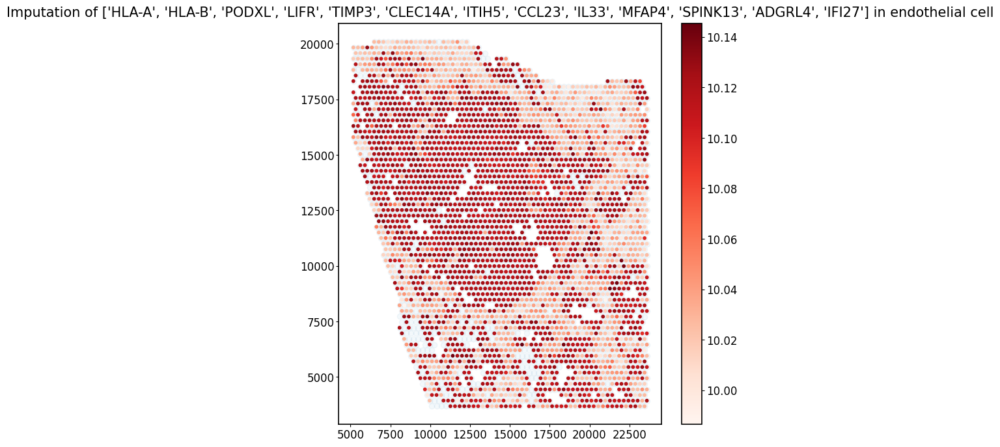

In [56]:
plt.figure(figsize=(8, 8))

ct_name = "endothelial cell"
gene_name = ["HLA-A", "HLA-B", "PODXL", "LIFR", "TIMP3", "CLEC14A", "ITIH5", 'CCL23', 'IL33', 'MFAP4', 'SPINK13', 'ADGRL4', 'IFI27']

# we must filter spots with low abundance (consult the paper for an automatic procedure)
indices = np.where(st_adata_pre.obsm["proportions"][ct_name].values > 0.01)[0]

# impute genes and combine them
specific_expression = np.sum(st_model.get_scale_for_ct(ct_name, indices=indices), 1)
specific_expression = np.log(1 + 1e4 * specific_expression)

# plot (i) background (ii) g
plt.scatter(st_adata_pre.obsm["spatial"][:, 0], st_adata_pre.obsm["spatial"][:, 1], alpha=0.05)
plt.scatter(st_adata_pre.obsm["spatial"][indices][:, 0], st_adata_pre.obsm["spatial"][indices][:, 1], 
            c=specific_expression, s=10, cmap="Reds")
plt.colorbar()
plt.title(f"Imputation of {gene_name} in {ct_name}")
plt.show()

HLA-A


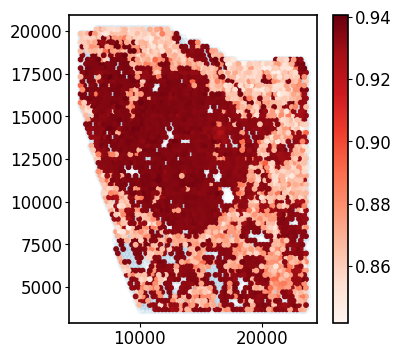

TIMP3


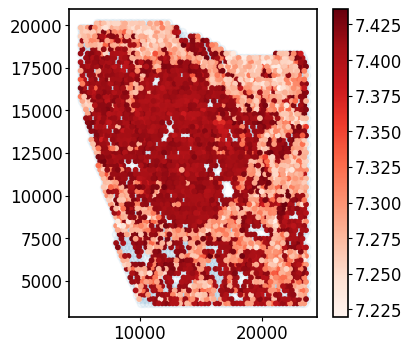

CCL23


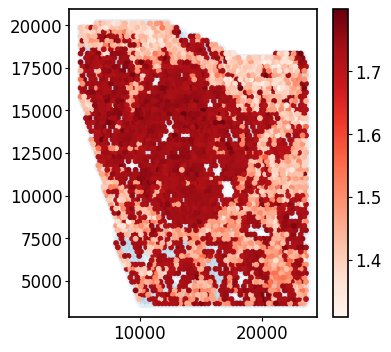

CLEC14A


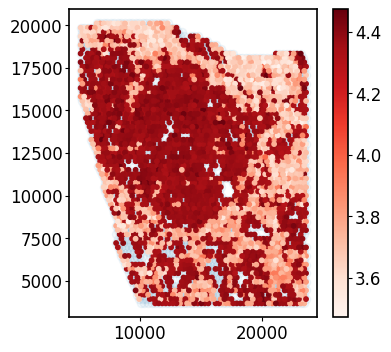

VWF


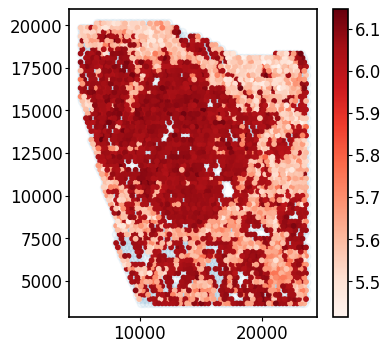

In [60]:
for i in ['HLA-A', 'TIMP3', 'CCL23', 'CLEC14A', 'VWF']:
    print(i)
    # we must filter spots with low abundance (consult the paper for an automatic procedure)
    indices = np.where(st_adata_pre.obsm["proportions"][ct_name].values > 0.01)[0]

    # impute genes and combine them
    specific_expression = st_model.get_scale_for_ct(ct_name, indices=indices)[i]
    specific_expression = np.log(1 + 1e5 * specific_expression)

    # plot (i) background (ii) g
    plt.scatter(st_adata_pre.obsm["spatial"][:, 0], st_adata_pre.obsm["spatial"][:, 1], alpha=0.05)
    plt.scatter(st_adata_pre.obsm["spatial"][indices][:, 0], st_adata_pre.obsm["spatial"][indices][:, 1], 
                c=specific_expression, s=10, cmap="Reds")
    plt.colorbar()
    plt.show()

In [62]:
specific_expression = st_model.get_scale_for_ct(ct_name)
color = np.log(1 + 1e5 * specific_expression["IFI27"].values)
threshold = 4.

mask = color > threshold
mask2 = color < threshold

_ = destvi_utils.de_genes(
    st_model, mask=mask, mask2=mask2, threshold=0.01, ct=ct_name, key="IFN_rich", key_proportions='proportions', st_adata=st_adata_pre
)

display(st_adata_pre.uns["IFN_rich"]["de_results"].head(30))

destvi_utils.plot_de_genes(
    st_adata_pre,
    interesting_genes=['CLEC14A', 'ADGRF5', 'CAVIN2', 'MYLK', 'IFI27'],
    key="IFN_rich",
)

ValueError: Data passed to ks_2samp must not be empty